In [1]:
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb

import os
import tasklogger
import pickle
import re # regexp
import itertools
import time

import scprep
import scanpy as sc
import scvi
import graphtools as gt
import magic
import umap
import anndata
import sklearn

#plt.rcParams['figure.figsize']=(6,6) #rescale figures
#import warnings
#warnings.simplefilter(action='ignore', category=FutureWarning)

Global seed set to 0


In [3]:
scseqDir = '/Users/idse/data_tmp/scRNAseq/'
dataDir = scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/';
sc.settings.figdir = dataDir

## Tyser data with our new read mapping

In [28]:
dataDir = scseqDir + 'human_gastrula/';
annotationFile = dataDir + 'annot_umap.csv';

In [11]:
enstoname = pd.read_csv(scseqDir + 'human_gastrula/geneInfo.tab',sep='\t',header=None,skiprows=1)
enstoname = pd.DataFrame(enstoname[1].to_numpy(), index=enstoname[0].to_numpy(),columns=['GeneSymbol'])

In [12]:
enstoname

,GeneSymbol
ENSG00000223972.5,DDX11L1
ENSG00000227232.5,WASH7P
ENSG00000278267.1,MIR6859-1
ENSG00000243485.5,MIR1302-2HG
ENSG00000284332.1,MIR1302-2
...,...
ENSG00000276017.1,ENSG00000276017
ENSG00000278817.1,ENSG00000278817
ENSG00000277196.4,ENSG00000277196
ENSG00000278625.1,U6


In [13]:
dataraw = pd.read_csv(scseqDir + 'human_gastrula/CraigCounts.csv',sep='\t',index_col='GeneID');
dataraw.drop(columns=['Chr','Start','End','Strand','Length'],inplace=True)
dataraw.columns = [int(g[5:12]) for g in list(dataraw.columns)]

In [14]:
dataraw = dataraw.transpose()

In [15]:
dataraw

GeneID,ENSG00000223972.5,ENSG00000227232.5,ENSG00000278267.1,ENSG00000243485.5,ENSG00000284332.1,ENSG00000237613.2,ENSG00000268020.3,ENSG00000240361.2,ENSG00000186092.7,ENSG00000238009.6,...,ENSG00000273739.1,ENSG00000276700.1,ENSG00000276312.1,ENSG00000275757.1,ENSG00000278573.1,ENSG00000276017.1,ENSG00000278817.1,ENSG00000277196.4,ENSG00000278625.1,ENSG00000277374.1
7785279,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
7785280,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7785281,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7785282,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7785283,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,7,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7788385,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7788387,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7788388,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7788390,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
# not all names are unique
#len(np.unique(enstoname.loc[dataraw['GeneID']].to_numpy()))
len(np.unique(enstoname.loc[dataraw.columns].to_numpy()))

60347

In [17]:
# range of cell numbers
max(dataraw.index)- min(dataraw.index)

3112

In [18]:
# number of genes with actual reads
np.sum(np.sum(dataraw,axis=0)>0)

36362

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/scprep/plot/utils.py:104: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


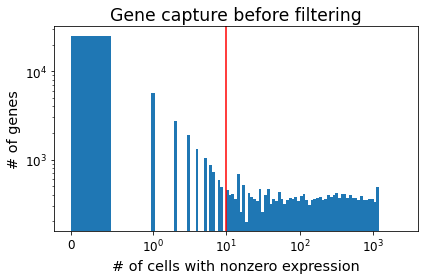

In [19]:
# filter genes
scprep.plot.histogram(scprep.measure.gene_capture_count(dataraw), log=True, cutoff=10,
                      title="Gene capture before filtering",
                     xlabel='# of cells with nonzero expression',
                     ylabel='# of genes');

In [20]:
dataraw_filt = scprep.filter.filter_rare_genes(dataraw, min_cells=10)

In [22]:
len(np.unique(enstoname.loc[dataraw_filt.columns].to_numpy()))

21069

In [23]:
dataraw_filt.columns

Index(['ENSG00000227232.5', 'ENSG00000243485.5', 'ENSG00000241860.7',
       'ENSG00000279457.4', 'ENSG00000228463.10', 'ENSG00000237094.12',
       'ENSG00000230021.10', 'ENSG00000225972.1', 'ENSG00000225630.1',
       'ENSG00000237973.1',
       ...
       'ENSG00000210195.2', 'ENSG00000210196.2', 'ENSG00000276256.1',
       'ENSG00000273748.1', 'ENSG00000271254.7', 'ENSG00000276345.1',
       'ENSG00000278673.1', 'ENSG00000273554.4', 'ENSG00000278817.1',
       'ENSG00000277196.4'],
      dtype='object', name='GeneID', length=21080)

In [24]:
dataraw_filt.columns=list(enstoname.loc[dataraw_filt.columns]['GeneSymbol'])

In [25]:
data_norm, library_size = scprep.normalize.library_size_normalize(dataraw_filt, return_library_size=True)

In [26]:
data_log = scprep.transform.log(data_norm)

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.min(axis=None) will return a scalar min over the entire DataFrame. To retain the old behavior, use 'frame.min(axis=0)' or just 'frame.min()'
  return reduction(axis=axis, out=out, **passkwargs)


In [29]:
annotation = pd.read_csv(annotationFile,index_col='Unnamed: 0');
cellname2num = pd.DataFrame(annotation.index, index=[int(g[5:12]) for g in annotation['cell_name']])

In [30]:
cellname2num.loc[dataraw.index][0]

7785279     545
7785280    1116
7785281     637
7785282     947
7785283     602
           ... 
7788385     699
7788387     370
7788388     441
7788390     392
7788391     180
Name: 0, Length: 1184, dtype: int64

In [31]:
annotation_raw = annotation.loc[cellname2num.loc[dataraw.index][0]].copy()
annotation_raw.index = cellname2num[0][dataraw.index];
annotation_raw.index.name = 'Cell';
annotation_raw.index = annotation_raw.index.format();

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/scprep/plot/utils.py:104: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


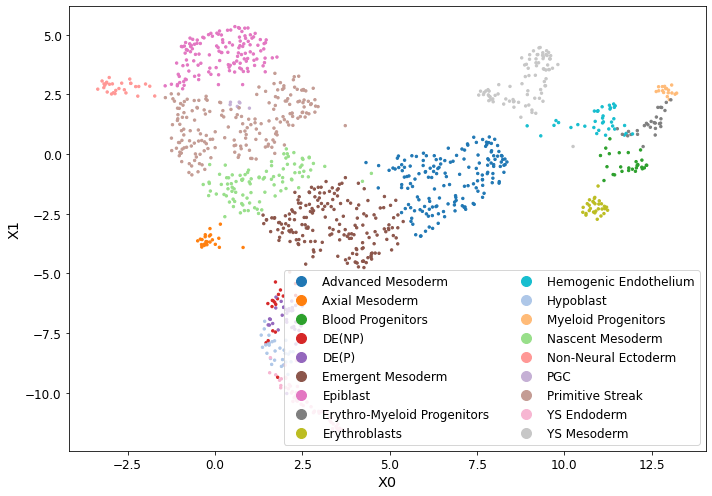

In [32]:
UMAP = annotation_raw[['X0','X1']];
#scprep.plot.scatter2d(UMAP,c=annotation_raw['cluster_id'],figsize=(10,7),legend=True);
scprep.plot.scatter2d(UMAP,c=annotation_raw['sub_cluster'],figsize=(10,7),legend=True);

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/scprep/plot/utils.py:104: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


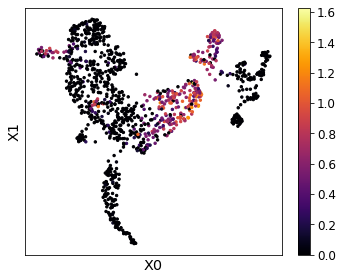

In [36]:
# check that gene expression looks sensible from Craig's data
scprep.plot.scatter2d(UMAP,c=data_log['HAND1'],figsize=(5,4),legend=True,ticks=False);

### Pre-process for SCVI

In [33]:
dataraw_filt.index = annotation_raw.index;

In [36]:
adata_tyser = anndata.AnnData(dataraw_filt, dtype=dataraw_filt.dtypes[1])
adata_tyser.var_names_make_unique()
adata_tyser.layers["counts"] = adata_tyser.X.copy()  # preserve counts
sc.pp.normalize_total(adata_tyser, target_sum=1e4)
sc.pp.log1p(adata_tyser)
adata_tyser.raw = adata_tyser.copy();
adata_tyser.obsm['X_umap']=annotation_raw[['X0','X1']].to_numpy();
adata_tyser.obsm['X_umap_original']=annotation_raw[['X0','X1']].to_numpy();
adata_tyser.obs = annotation_raw[['sub_cluster','cluster_id']].copy();
adata_tyser

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 1184 × 21080
    obs: 'sub_cluster', 'cluster_id'
    uns: 'log1p'
    obsm: 'X_umap', 'X_umap_original'
    layers: 'counts'

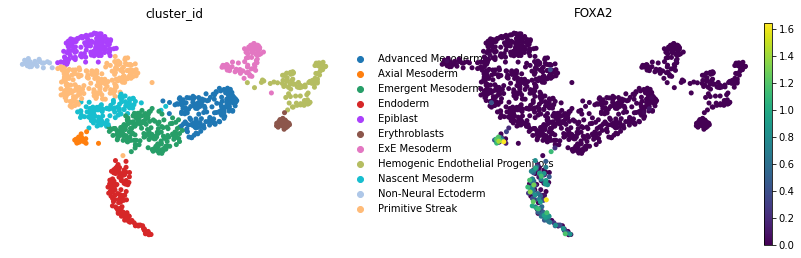

In [35]:
sc.pl.umap(
    adata_tyser,
    color=['cluster_id','FOXA2'],
    frameon=False,
    ncols=2,
)

In [239]:
#adata_tyser.write_h5ad(dataDir + 'tyser_craigmapped.h5ad')

## Load and filter gastruloid data

In [44]:
# data location
dataDir = scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/per_sample_outs/'
countMatrixFiles = [#dataDir + '9704-BC-1/count/sample_raw_feature_bc_matrix.h5',
                    dataDir + '9704-BC-2/count/sample_raw_feature_bc_matrix.h5',
                    dataDir + '9704-BC-3/count/sample_raw_feature_bc_matrix.h5',
                    dataDir + '9704-BC-4/count/sample_raw_feature_bc_matrix.h5'];
    
conditions = ['48h','72h','96h']#'0h',

In [45]:
# load data in sparse format
data = {};
for i in range(1,len(conditions)+1) :
    with tasklogger.log_task("sparse"):
        data[conditions[i-1]] = scprep.io.load_10X_HDF5(countMatrixFiles[i-1],
                                        sparse=True, gene_labels='both')

    # measure the size of the matrix with pickle
    print("Size: {:.1f}MB".format(len(pickle.dumps(data)) / 1024**2))

Calculating sparse...
Calculated sparse in 19.78 seconds.
Size: 1631.2MB
Calculating sparse...
Calculated sparse in 16.35 seconds.
Size: 3074.5MB
Calculating sparse...
Calculated sparse in 10.37 seconds.
Size: 4277.9MB


In [46]:
for key in data :
    print(data[key].shape)

(716962, 37143)
(709554, 37143)
(703670, 37143)


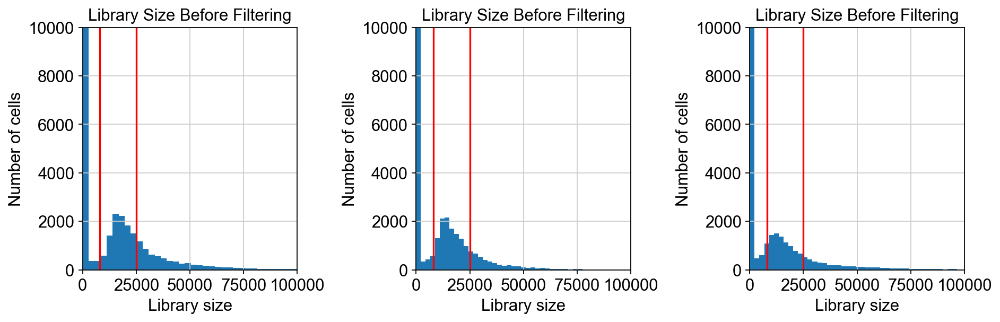

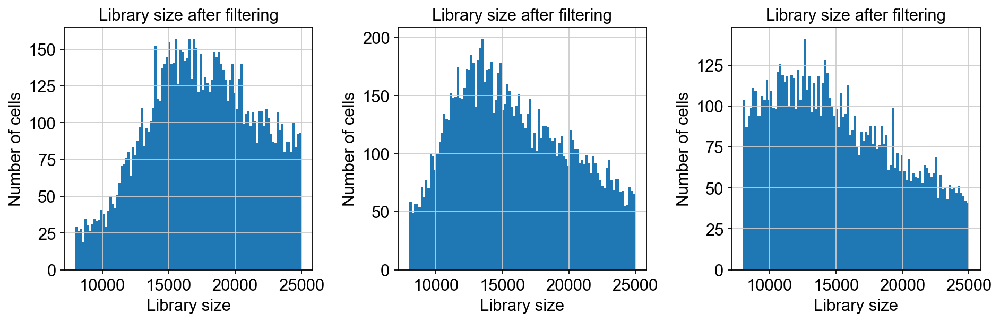

In [81]:
minls = 8000;
maxls = 25000;
libcutoffs = [(minls,maxls),(minls,maxls),(minls,maxls)] #(minls,50000),

fig, axes = plt.subplots(1,len(conditions), figsize=(len(conditions)*4,4))
# This makes it easier to iterate through the axes
axes = axes.flatten()

for i, ax in enumerate(axes):

    scprep.plot.plot_library_size(data[conditions[i]], cutoff=libcutoffs[i], log=False, title='Library Size Before Filtering', ax=ax);
    ax.set_xlim([0, 100000])
    ax.set_ylim([0, 10000])

fig.tight_layout()

fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
# This makes it easier to iterate through the axes
axes = axes.flatten()
for i, ax in enumerate(axes):

    scprep.plot.plot_library_size(data[conditions[i]], log=False, range=libcutoffs[i], title='Library size after filtering',ax=ax);

fig.tight_layout()    

In [82]:
data_filt = {};
for i in range(0,len(conditions)) :
    data_filt[conditions[i]] = scprep.filter.filter_library_size(data[conditions[i]], cutoff=libcutoffs[i], keep_cells='between');
    print(data_filt[conditions[i]].shape)

(9853, 37143)
(11505, 37143)
(8481, 37143)


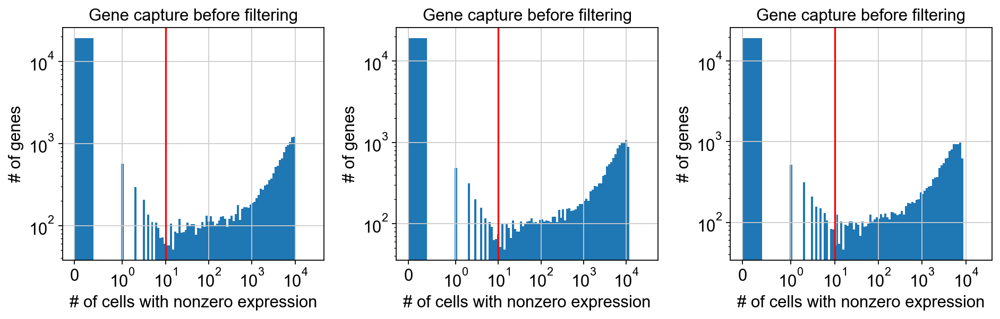

In [83]:
fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
# This makes it easier to iterate through the axes
axes = axes.flatten()
for i, ax in enumerate(axes):
    scprep.plot.histogram(scprep.measure.gene_capture_count(data_filt[conditions[i]]), log=True, cutoff=10,
                      title="Gene capture before filtering",
                     xlabel='# of cells with nonzero expression',
                     ylabel='# of genes',ax=ax);
fig.tight_layout() 

In [84]:
data_filt_tmp = {};
for i in range(0,len(conditions)) :
    data_filt_tmp[conditions[i]] = scprep.filter.filter_rare_genes(data_filt[conditions[i]], min_cells=10)
    print(data_filt_tmp[conditions[i]].shape)
    
cols = [];
for i in range(0,len(conditions)) :
    cols = np.union1d(cols, data_filt_tmp[conditions[i]].columns);
cols.shape

for i in range(0,len(conditions)) :
    data_filt[conditions[i]] = data_filt[conditions[i]][cols]
    print(data_filt[conditions[i]][cols].shape)

(9853, 16252)
(11505, 16358)
(8481, 16110)
(9853, 16624)
(11505, 16624)
(8481, 16624)


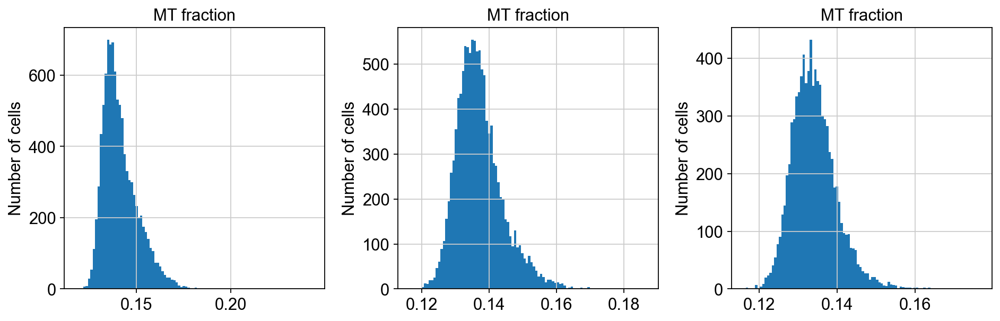

In [85]:
# check mitochondrial fraction 
fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
axes = axes.flatten()
mt_frac = {};
for i, ax in enumerate(axes):
    mt_expr = get_genes_expression(data_filt[conditions[i]], 'MT-')  
    libsize = np.sum(data_filt[conditions[i]], axis=1)
    mt_frac[i] = mt_expr/libsize
    scprep.plot.histogram(mt_frac[i], title='MT fraction',ax=ax);
fig.tight_layout() 

In [86]:
for i in range(0,len(conditions)):
    data_filt[conditions[i]] = data_filt[conditions[i]][mt_frac[i]<0.2];

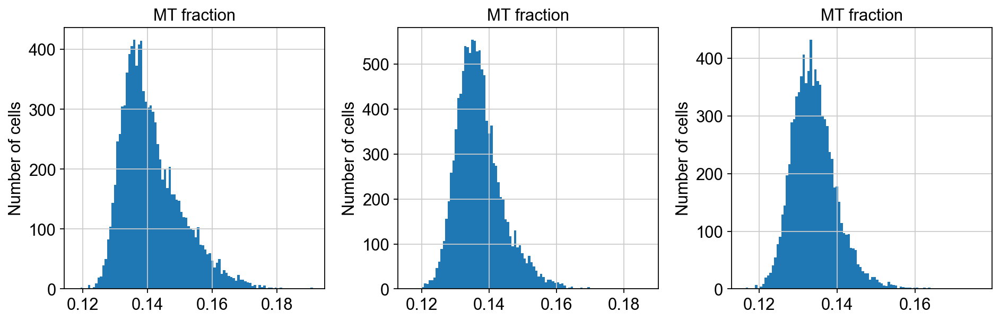

In [87]:
# check mitochondrial fraction again
fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
axes = axes.flatten()
mt_frac = {};
for i, ax in enumerate(axes):
    mt_expr = get_genes_expression(data_filt[conditions[i]], 'MT-')  
    libsize = np.sum(data_filt[conditions[i]], axis=1)
    mt_frac[i] = mt_expr/libsize
    scprep.plot.histogram(mt_frac[i], title='MT fraction',ax=ax);
fig.tight_layout() 

In [88]:
filtered_batches = []
for key in data_filt:
    filtered_batches.append(data_filt[key])

In [89]:
data_combined, sample_labels = scprep.utils.combine_batches(filtered_batches, conditions)
del filtered_batches # removes objects from memory

In [57]:
data_combined.shape

(30840, 16638)

In [90]:
data_combined.shape

(29836, 16624)

In [91]:
adata_combined = anndata.AnnData(X=data_combined)
adata_combined.obs['sample_labels'] = sample_labels;

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_70930/2365217404.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_combined = anndata.AnnData(X=data_combined)


In [92]:
adata_combined.layers["counts"] = adata_combined.X.copy() # preserve counts
sc.pp.normalize_total(adata_combined, target_sum=1e4, key_added='total_counts')
sc.pp.log1p(adata_combined)
adata_combined.raw = adata_combined # freeze the state in `.raw`

In [61]:
adata_combined.obs['total_counts']

AAACAAGCAACGACTAATCATGTG-1_48h    16288.0
AAACAAGCAGCAATTGATCATGTG-1_48h    13264.0
AAACAAGCATCAGGACATCATGTG-1_48h    14551.0
AAACAAGCATCCCTCTATCATGTG-1_48h    19118.0
AAACAAGCATTCATGCATCATGTG-1_48h    15152.0
                                   ...   
TTTGGCGGTTGCGGGAATTCGGTT-1_96h    21026.0
TTTGTGAGTGCGTACCATTCGGTT-1_96h     5916.0
TTTGTGAGTGTCCTTCATTCGGTT-1_96h    14884.0
TTTGTGAGTTCACTCCATTCGGTT-1_96h    13546.0
TTTGTGAGTTCCGTGAATTCGGTT-1_96h    19604.0
Name: total_counts, Length: 30840, dtype: float32

In [101]:
# SAVE
adata_combined.write_h5ad(dataDir + 'adata_timeseries2024_487296_v2.h5ad')

In [41]:
# LOAD
#adata_combined = sc.read_h5ad(dataDir + 'adata_timeseries2024_487296_v2.h5ad')

## Integrate gastruloid timeseries

In [18]:
adata_combined_2024 = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries2024_487296_v2.h5ad')

In [19]:
adata_combined_2021 = sc.read_h5ad(scseqDir + '211113_ESI_MP48_72_96h scRNA data/adata_timeseries2021_487296.h5ad');

In [20]:
sharedvar = list(set(adata_combined_2024.var_names).intersection(set(adata_combined_2021.var_names)));
len(sharedvar)

16233

In [21]:
adata_combined_2021.obs['sample_labels'] = [g + '-1' for g in adata_combined_2021.obs['sample_labels']]
adata_combined_2024.obs['sample_labels'] = [g + '-2' for g in adata_combined_2024.obs['sample_labels']]

In [22]:
adata_all = anndata.concat([adata_combined_2024[:,sharedvar], adata_combined_2021[:,sharedvar]])
adata_all

AnnData object with n_obs × n_vars = 46508 × 16233
    obs: 'sample_labels'
    layers: 'counts'

In [23]:
sc.pp.highly_variable_genes(
    adata_all,
    n_top_genes=1000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
)

In [24]:
# load cell cycle genes
cc_genes_file = scseqDir + 'Macosko_cell_cycle_genes.txt'
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()
m_genes = cc_genes['M'].dropna()
mg1_genes = cc_genes['M.G1'].dropna()

nuisance_genes = [g for g in adata_all.var_names if g.split()[0] in set(list(s_genes)+list(m_genes)+list(g2m_genes))]

In [25]:
len(nuisance_genes)

37

In [26]:
adata_all.raw.X.shape

(46508, 16233)

In [89]:
gene_subset = [g for g in adata_all.var_names if g not in nuisance_genes]
adata_all_cc = adata_all.copy();
adata_all_cc = adata_all_cc[:,gene_subset].copy()
adata_all_cc.obs = pd.concat([adata_all.obs, adata_all[:,nuisance_genes].to_df()],axis=1);

In [90]:
import scvi
scvi.model.SCVI.setup_anndata(adata_all_cc, layer="counts", batch_key="sample_labels", continuous_covariate_keys=nuisance_genes)

In [91]:
vae = scvi.model.SCVI(adata_all_cc, n_layers=2, n_latent=30, gene_likelihood="nb")
vae.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 172/172: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 172/172 [25:54<00:00,  9.04s/it, loss=812, v_num=1]


In [17]:
# save the reference model
# dir_path = "240306_alltimeseries_cc_scvi_model_487296_hvg1000"
# vae.save(dir_path, overwrite=True)

In [92]:
adata_all_cc.obsm["X_scVI_cc"] = vae.get_latent_representation()

In [93]:
adata_all_cc.layers['normalized_cc'] = vae.get_normalized_expression()

In [94]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_cc, use_rep="X_scVI_cc")
sc.tl.umap(adata_all_cc, min_dist=0.1) 

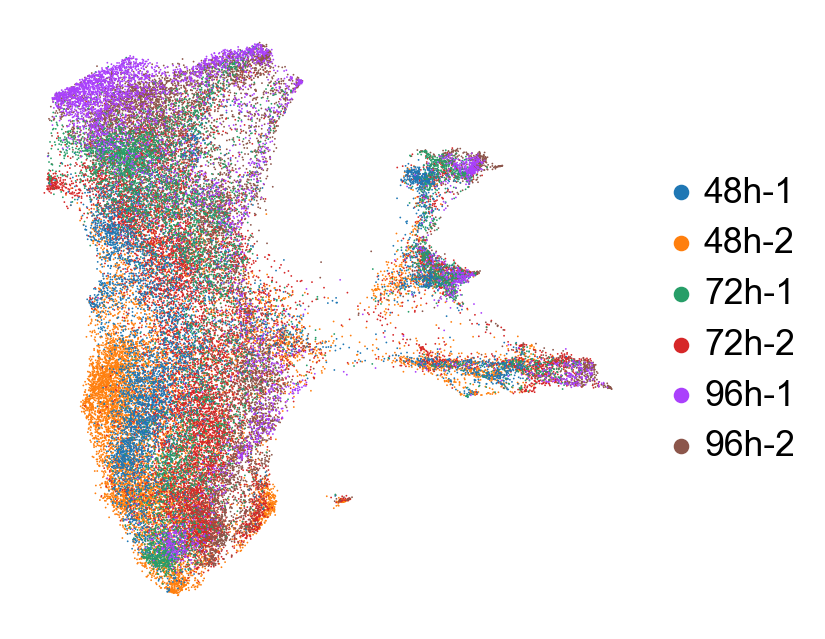

In [65]:
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    adata_all_cc,
    color=["sample_labels"],
    frameon=False,
    title=[""],
    ncols=5,
    legend_fontsize=16,
#    save='_gastruloid_all_sample_labels_v2.png'
)

In [66]:
Nclusters = len(np.unique(adata_all_cc.obs['leiden']));
mypalette = sb.color_palette('tab10', Nclusters);
sc.set_figure_params(figsize=[5,5])

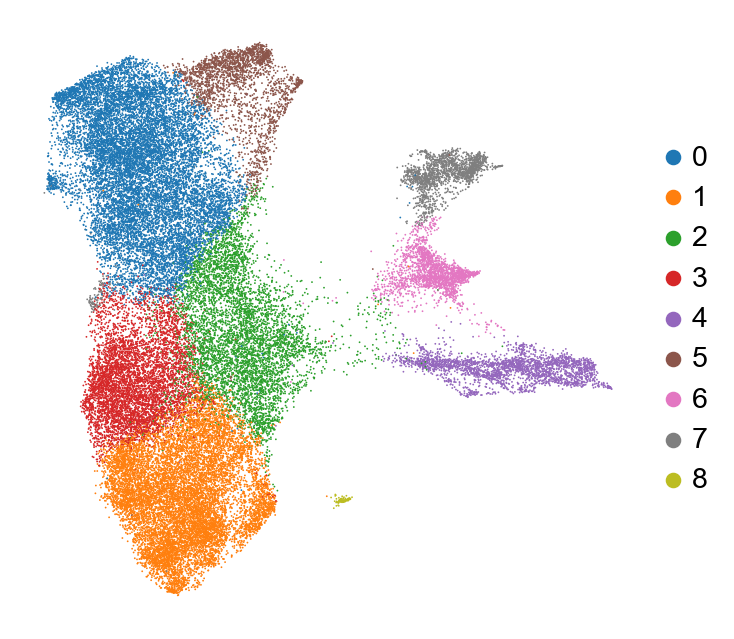

In [67]:
sc.tl.leiden(adata_all_cc, resolution=0.5, random_state=8)
sc.pl.umap(
    adata_all_cc,
    color=["leiden"],
    title=[""],
    palette=mypalette,
    frameon=False,
    ncols=5,
    #save='_gastruloid_all_leiden_v2.png'
)

In [132]:
#adata_all_cc.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');

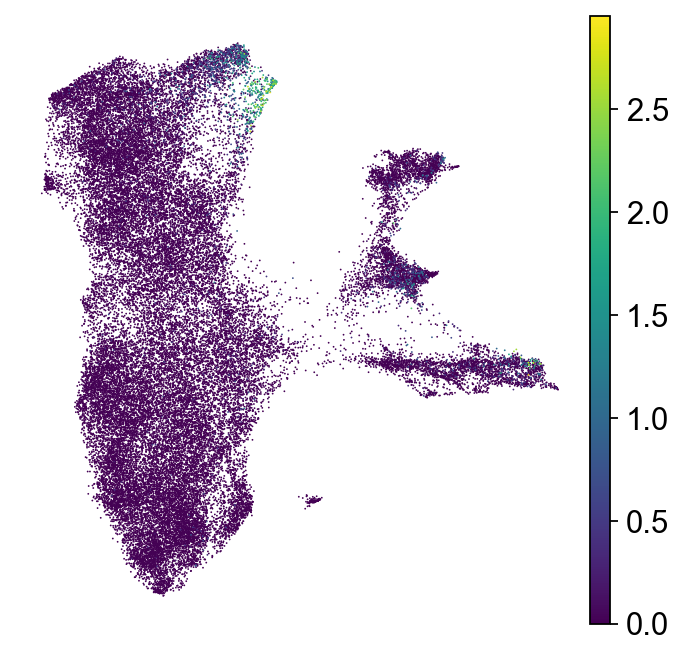

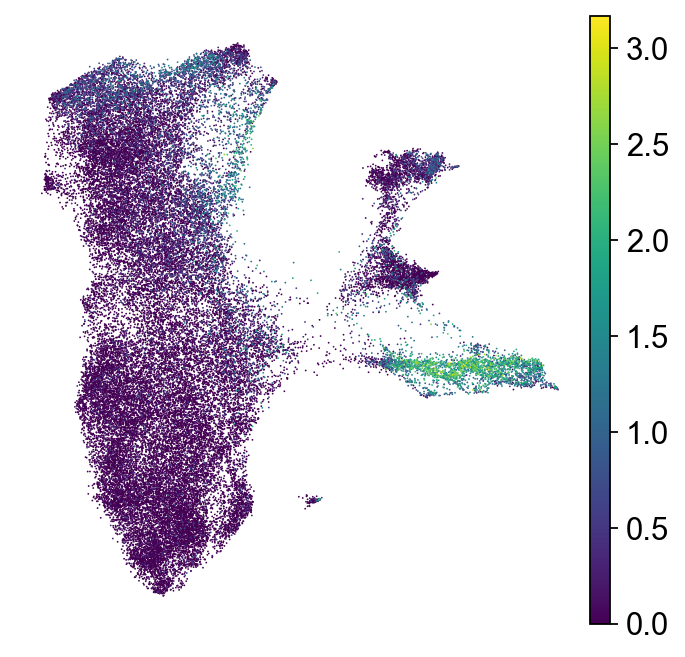

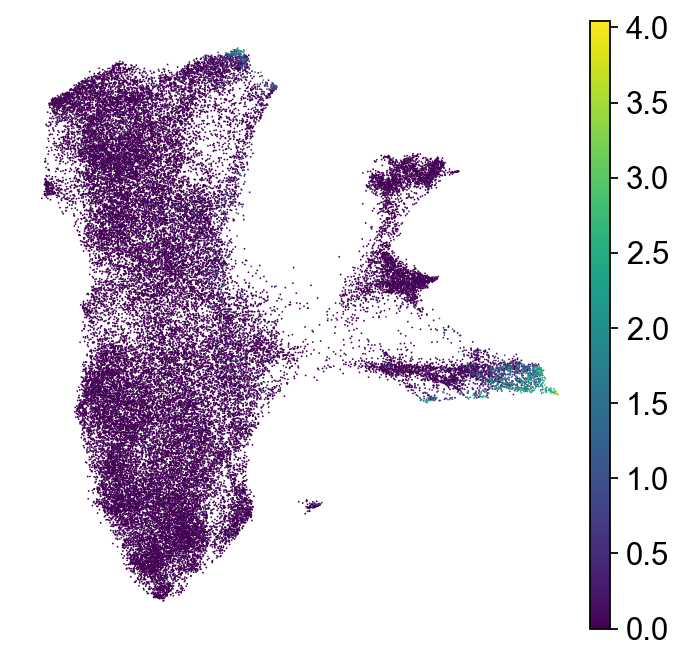

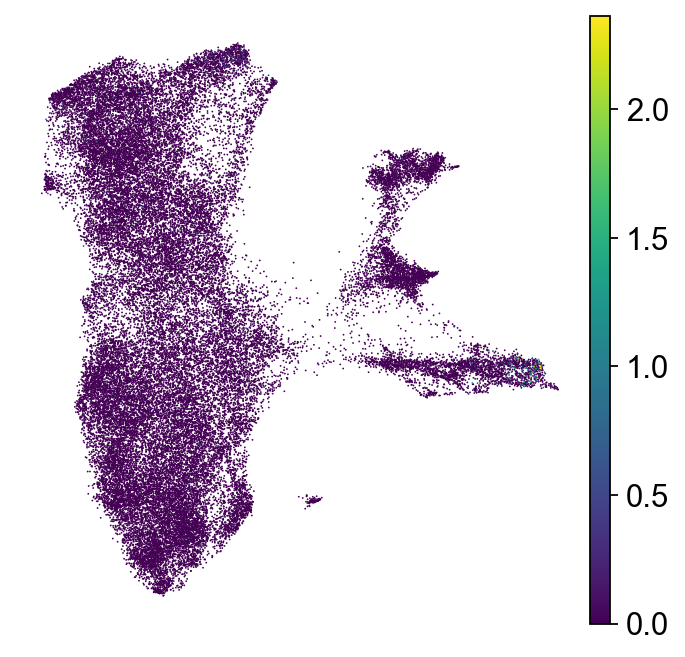

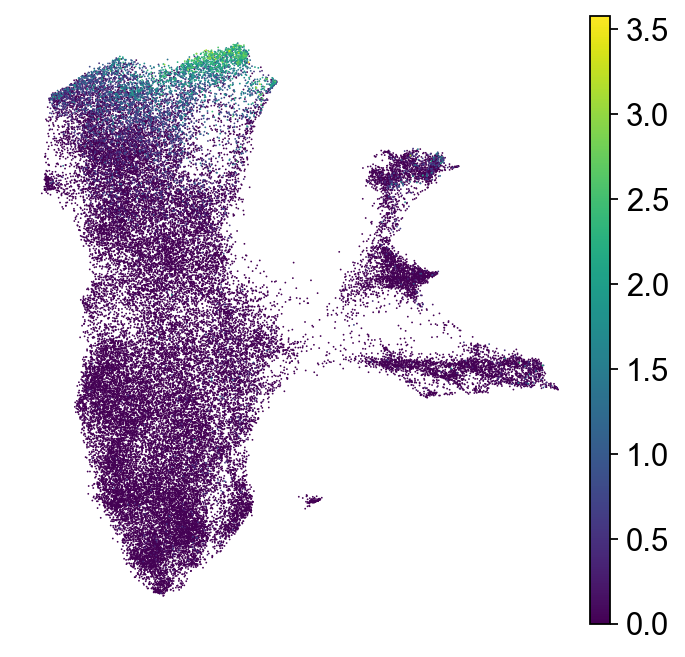

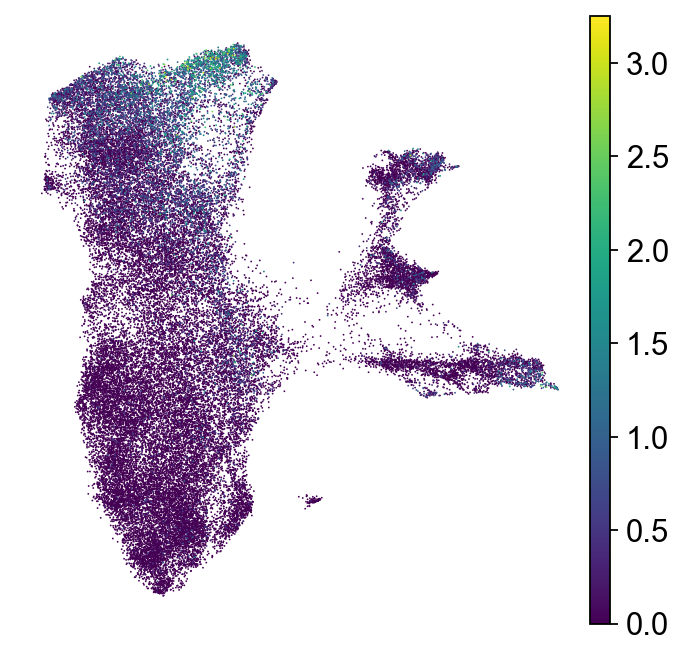

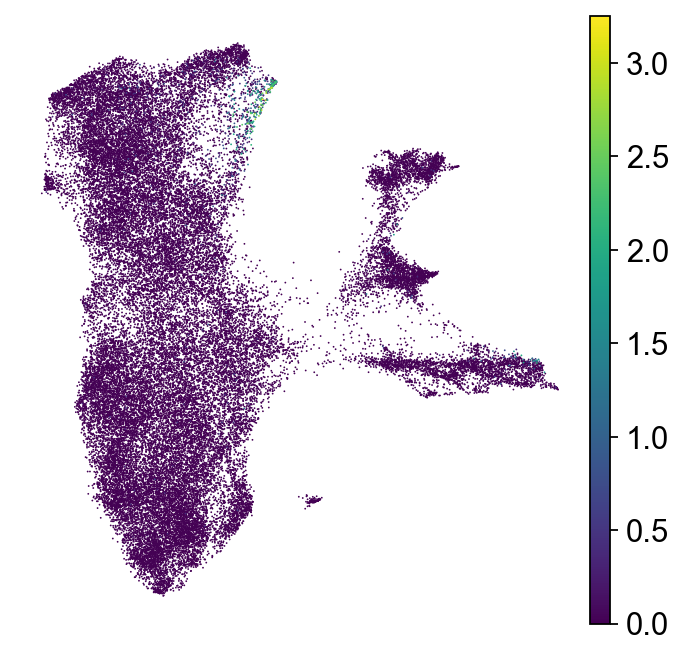

In [68]:
mygenes = ["PITX1","ISL1","ANXA1","DCN","MYL4","MYL7","TBX4"];

sc.set_figure_params(figsize=[5,5])
for i in range(0,len(mygenes)):
    mygenes_fullname = [g for g in adata_all_cc.raw.var_names if g.split()[0] in mygenes[i]];
    sc.pl.embedding(
        adata_all_cc,
        use_raw=True,
        basis='X_umap',
        color=[mygenes_fullname[0]],
        frameon=False,
        title=[""],
        ncols=2,
        save='gastruloid_'+ mygenes[i] +'.png'
    )

### MAGIC to clean up

In [64]:
#adata_all_cc = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');

In [69]:
data_all_cc = pd.DataFrame(adata_all_cc.raw.X.todense(), index=adata_all_cc.obs.index, columns=adata_all_cc.raw.var_names);

In [70]:
data_all_cc_magic = magic.MAGIC(knn=5,t=1).fit_transform(data_all_cc)

Calculating MAGIC...
  Running MAGIC on 46508 cells and 16233 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 16.20 seconds.
    Calculating KNN search...
    Calculated KNN search in 255.59 seconds.
    Calculating affinities...
    Calculated affinities in 248.78 seconds.
  Calculated graph and diffusion operator in 522.15 seconds.
  Running MAGIC with `solver='exact'` on 16233-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 19.92 seconds.
Calculated MAGIC in 543.58 seconds.


In [71]:
adata_all_cc_magic = anndata.AnnData(data_all_cc_magic)
adata_all_cc_magic.obs = adata_all_cc.obs;
adata_all_cc_magic.obsm = adata_all_cc.obsm;

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_24330/2755517863.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_all_cc_magic = anndata.AnnData(data_all_cc_magic)


In [72]:
adata_all_cc_magic.obs.drop(columns=nuisance_genes,inplace=True)

In [73]:
adata_all_cc_magic.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_magic.h5ad')

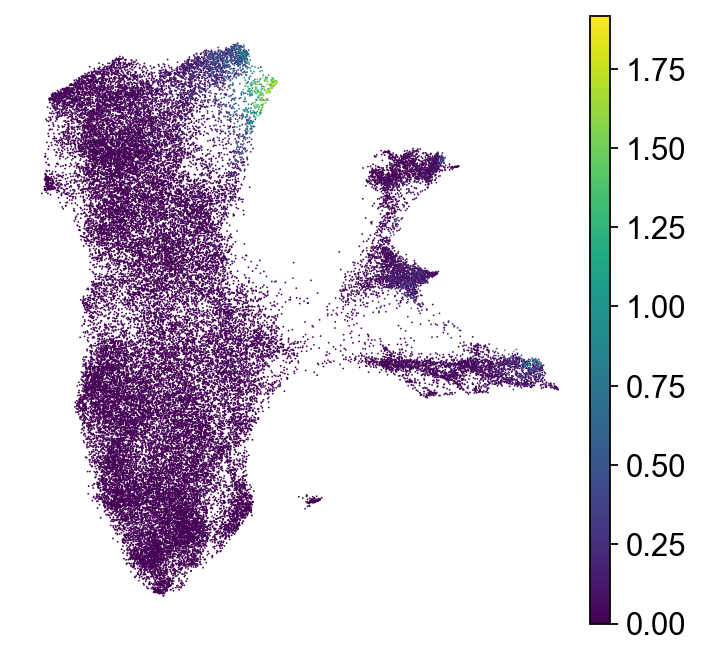

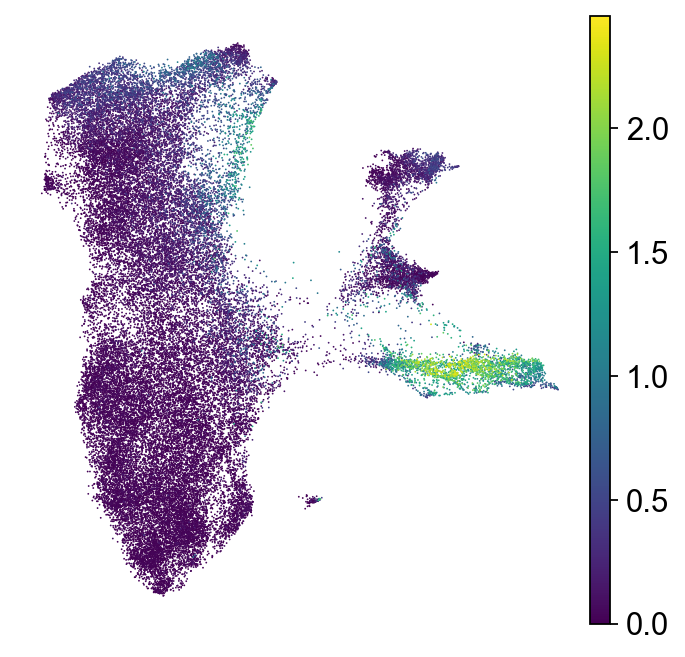

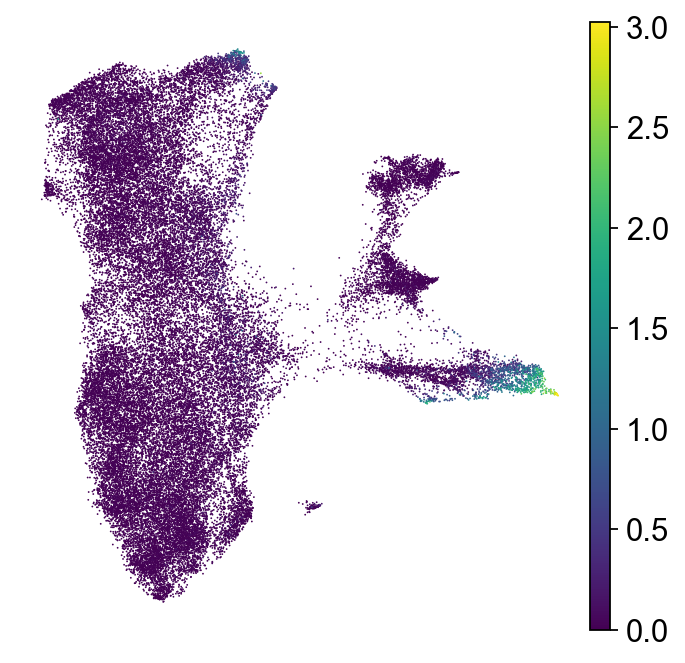

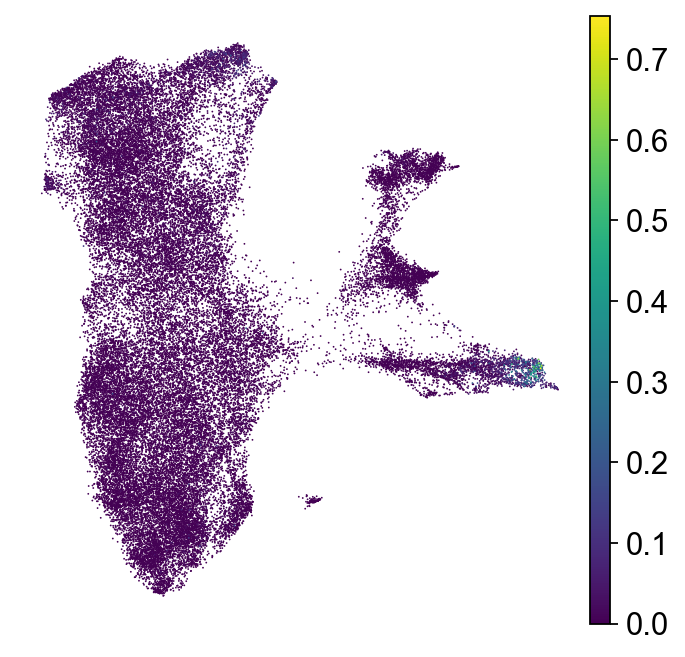

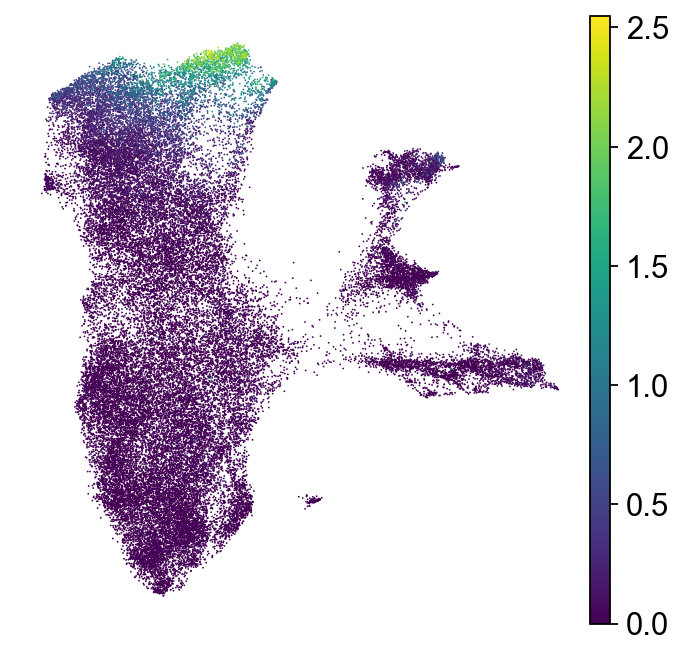

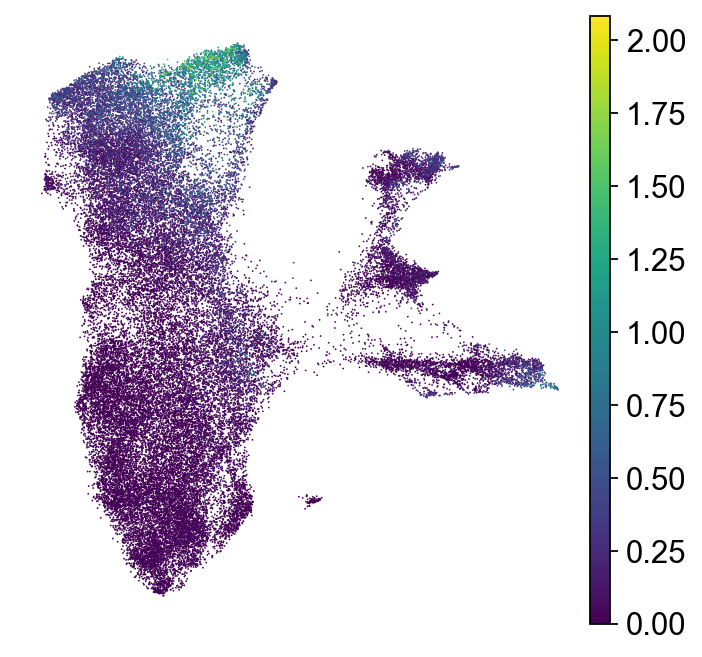

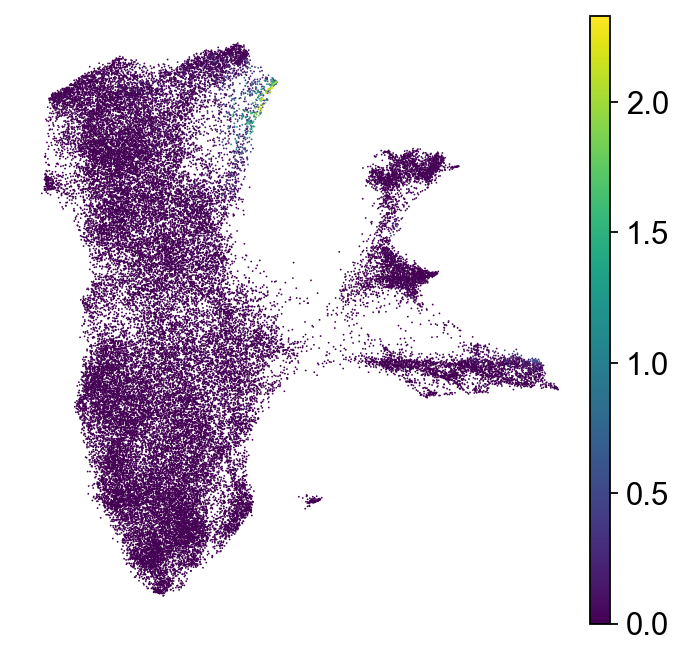

In [74]:
mygenes = ["PITX1","ISL1","ANXA1","DCN","MYL4","MYL7","TBX4"];

sc.set_figure_params(figsize=[5,5])
for i in range(0,len(mygenes)):
    
    mygenes_fullname = [g for g in adata_all_cc.raw.var_names if g.split()[0] in mygenes[i]];
    sc.pl.embedding(
        adata_all_cc_magic,
        use_raw=False,
        basis='X_umap',
        color=[mygenes_fullname[0]],
        frameon=False,
        title=[""],
        ncols=2,
        save='gastruloid_'+ mygenes[i] +'_magic.png'
    )

## Gastruloid clustering and gene expression

In [79]:
adata_all_cc = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');
clusterlabels = ['NasMe','pluripotent','PPS-LC','APS-LC','AE-LC','AdvMe','PGC-LC','DE','stressed'];
adata_all_cc.rename_categories('leiden', clusterlabels)

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1160: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  self.obs[key].cat.rename_categories(categories, inplace=True)


In [80]:
mypalette = sb.color_palette('tab10', 10).copy();

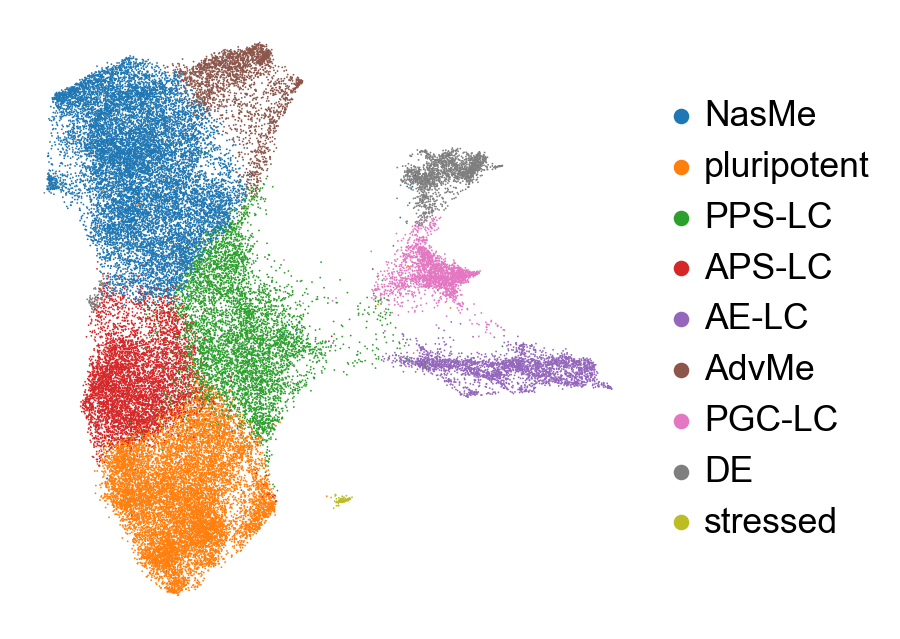

In [81]:
Nclusters = len(np.unique(adata_all_cc.obs['leiden']));
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    adata_all_cc,
    color=["leiden"],
    title=[""],
    palette=mypalette,#sb.color_palette('tab10', Nclusters),
    frameon=False,
    ncols=5,
    legend_fontsize=16,
    #save='_gastruloid_all_leiden_v2.png'
)

In [144]:
#adata_all_cc.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/240306_adata_timeseries_all_cc_hvg1000_leiden06_5.h5ad')

### Marker genes full data

26


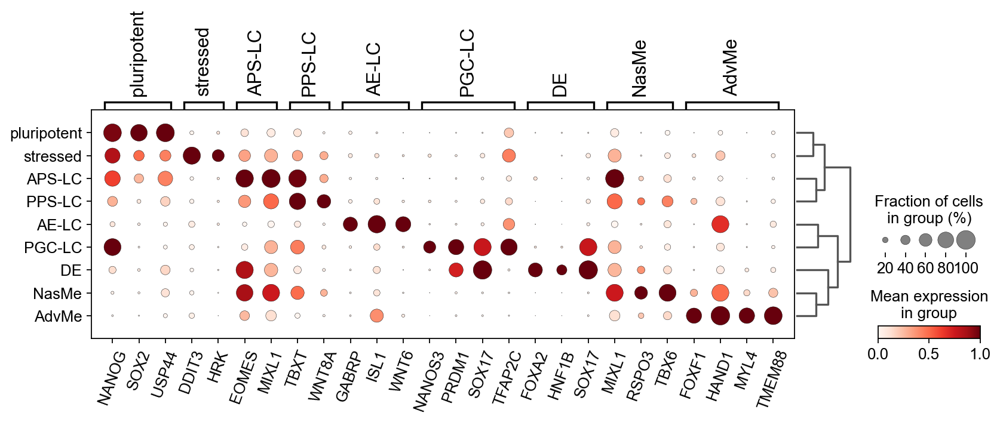

In [82]:
plt.rcParams.update({'font.weight':'regular'})

PMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['TBX6','MIXL1','RSPO3']]; #'FOXC1',
plurimarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['NANOG','SOX2','USP44']];
apsmarkers= [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['EOMES','MIXL1']];
ppsmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['TBXT','WNT8A']]; # CDX2
ammarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['GABRP','WNT6','ISL1']]
lpmmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['FOXF1','HAND1',"TMEM88","MYL4"]] #"NKX2-5",
DEmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['SOX17',"FOXA2","HNF1B"]]
PGCmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['NANOS3',"TFAP2C","SOX17","PRDM1"]];
stressedmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['DDIT3','HRK']]

marker_genes_dict = {'NasMe':PMmarkers,'pluripotent':plurimarkers,'APS-LC':apsmarkers,'PPS-LC':ppsmarkers,'AE-LC':ammarkers,'AdvMe':lpmmarkers,'PGC-LC':PGCmarkers,'stressed':stressedmarkers,'DE':DEmarkers}

allmarkers=[];
for key in marker_genes_dict:
    allmarkers = allmarkers + marker_genes_dict[key]
print(len(allmarkers))
ax_dict = sc.pl.dotplot(adata_all_cc, marker_genes_dict, groupby='leiden', dendrogram=True, show=False, standard_scale='var');#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
plt.savefig(dataDir+'dotplot_markers_horizontal_v2.png',dpi=300, bbox_inches = "tight")
    
# ax_dict = sc.pl.dotplot(adata_all_cc, marker_genes_dict, groupby='leiden', dendrogram=True, show=False, swap_axes=True);#, return_fig=True);
# ax_dict['mainplot_ax'].get_yticklabels();
# ax_dict['mainplot_ax'].set_yticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_yticklabels()]);
# plt.savefig(dataDir+'dotplot_markers_vertical.png',dpi=300, bbox_inches = "tight")

#dp = sc.pl.dotplot(adata, markers, 'bulk_labels', return_fig=True)


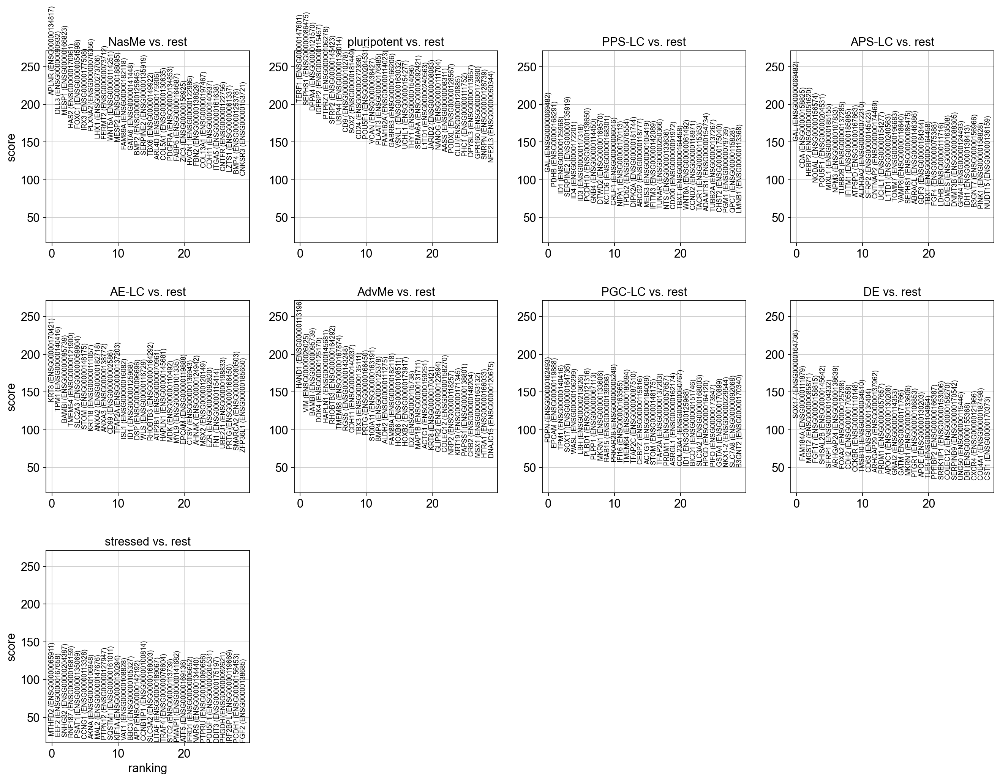

In [129]:
plt.rcParams['figure.figsize']=(5,5)
sc.tl.rank_genes_groups(adata_all_cc, groupby='leiden', key_added='rank_leiden_ttest', method='t-test') #method='wilcoxon') 
sc.pl.rank_genes_groups(adata_all_cc, key='rank_leiden_ttest', fontsize=8, n_genes=30)

In [83]:
data_all_cc = pd.DataFrame(adata_all_cc.raw.X.toarray(), index=adata_all_cc.obs.index, columns=adata_all_cc.raw.var_names);

In [84]:
data_all_cc_scaled = sklearn.preprocessing.StandardScaler().fit_transform(data_all_cc.to_numpy())
data_all_cc_scaled = pd.DataFrame(data_all_cc_scaled, index=data_all_cc.index, columns=data_all_cc.columns)

In [85]:
#mean_diff_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up')
emd_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='emd')
#ranksum_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='ranksum')
#ttest_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='ttest')

In [86]:
#adata_all_cc.rename_categories('leiden', ['0','1','2','3','4','5','6','7','8'])
#adata_all_cc.rename_categories('leiden', clusterlabels)
dataDir = scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/';
clustermarkers_dict = dict();
for cl in emd_results_scaled : 
    clustermarkers_dict[cl] = pd.DataFrame(emd_results_scaled[cl].index[0:50],columns=[cl]);#pd.DataFrame;
clustermarkers = pd.concat(clustermarkers_dict.values(),axis=1)
clustermarkers.to_csv(dataDir+'emd_clustermarkers.csv')
for col in clustermarkers.columns :
    clustermarkers[col] = clustermarkers[col].str.split(expand=True)[0]
clustermarkers.to_excel(dataDir+'emd_clustermarkers.xlsx')
pd.set_option('display.max_rows', None)
clustermarkers

,AE-LC,APS-LC,AdvMe,DE,NasMe,PGC-LC,PPS-LC,pluripotent,stressed
0,IGFBP7,FGF4,HOXB8,SOX17,DLL3,PDPN,TACR1,SOX2,TAC1
1,TCIM,NODAL,CRB2,FOXA2,IRX3,NANOS3,WNT8A,USP44,ATF5
2,WNT6,FGF8,MYL4,CCKBR,FOXC1,VSTM2B,DTWD2,TERF1,DDIT3
3,EPAS1,CDA,RGS13,HNF1B,APLNR,PRDM1,KCTD6,VSNL1,INHBE
4,DLX5,HEBP2,TMEM88,CST1,LHX1,SOSTDC1,CHST2,PTPRZ1,GDF15
5,SLC8A1,GAL,HOXB6,BHLHE22,MESP1,PLBD1,SPATA16,SEPHS1,TRIB3
6,GABRP,ALDH3A2,HOXB5,MNX1,PLXNA2,TFAP2C,ABCG2,DPPA4,LAMP3
7,SPNS2,MIXL1,ADGRA2,GATM,MESP2,FAM20A,ID4,AASS,NIBAN1
8,ISL1,GDF3,HOXB4,FGF17,WNT5A,SOX17,PDHB,IGFBP2,HRK
9,ANXA3,NPM3,TRPV2,GJA4,BMP2,RAB15,GAL,GPR160,AKNA


In [63]:
# calculate cluster means

clusters = adata_all_cc.obs['leiden'];
Nclusters = len(np.unique(clusters))
Ngenes = data_all_cc.shape[1]
cluster_means = np.zeros((Nclusters, Ngenes))
cluster_means_zscore = np.zeros((Nclusters, Ngenes))

for i, c in enumerate(np.unique(clusters)):
    cluster_means[i,:] = np.mean(data_all_cc.iloc[np.array(clusters==c),:],axis=0)
    cluster_means_zscore[i,:] = np.mean(data_all_cc_scaled.iloc[np.array(clusters==c),:],axis=0)
    
cluster_means = pd.DataFrame(cluster_means, columns=data_all_cc.columns, index=np.unique(clusters))
cluster_means_zscore = pd.DataFrame(cluster_means_zscore, columns=data_all_cc_scaled.columns, index=np.unique(clusters))

In [143]:
#cluster_means_zscore.to_csv(dataDir+'cluster_means_zscore.csv');
#cluster_means.to_csv(dataDir+'cluster_means.csv');

In [64]:
gene_names = [g.split()[0] for g in adata_all_cc.raw.var_names]
ensembol_ids = [g.split()[1] for g in adata_all_cc.raw.var_names]
gene2ensembol = dict(zip(gene_names, ensembol_ids))
deg = clustermarkers.unstack();
deg_fullnames = [g + ' ' + gene2ensembol[g] for g in deg]

NameError: name 'clustermarkers' is not defined

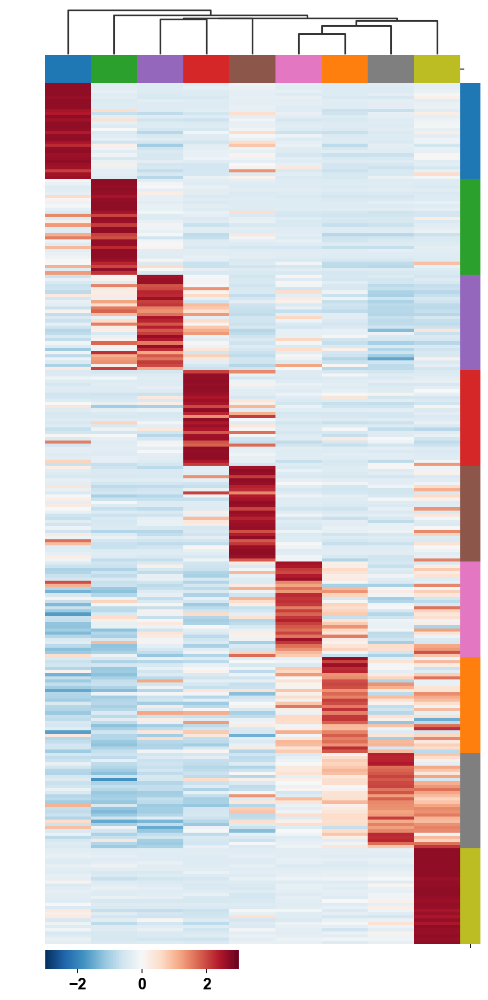

In [145]:
plt.rcParams.update({'font.size':13})
plt.rcParams.update({'font.weight':'bold'})
plt.rcParams.update({'axes.linewidth': 2})

cluster_colors = dict(zip(np.unique(clusters), sb.color_palette('tab10', Nclusters)))
col_colors = pd.DataFrame({'':[cluster_colors[i] for i in np.unique(clusters)]},index=cluster_means.index)

# trimmednames = [g.split()[0] for g in adata_all_cc.var_names];
#cols = [g for g in adata_all_cc.var_names if g.split()[0] in deg];

col_linkage = sp.cluster.hierarchy.linkage(cluster_means[deg_fullnames],optimal_ordering=True)
cluster_order = sp.cluster.hierarchy.leaves_list(col_linkage);

# reorder rows to match columns
deg = [];
rowcluster = np.zeros((0,));
for i, c in enumerate(np.unique(clusters)):
    markers_added = list(clustermarkers.iloc[:,cluster_order[i]]);
    deg = deg + markers_added;
    rowcluster = np.concatenate((rowcluster, np.ones(len(markers_added))*cluster_order[i]),axis=0);
deg_fullnames = [g + ' ' + gene2ensembol[g] for g in deg]
row_colors = pd.DataFrame(col_colors.iloc[rowcluster.astype('int')].to_numpy(), index=cluster_means[deg_fullnames].columns, columns=[""]);

g = sb.clustermap(cluster_means[deg_fullnames].transpose(), z_score=0, col_colors=col_colors, xticklabels=False,yticklabels=False,vmax=3,vmin=-3,dendrogram_ratio=0.05,figsize=(6,12),cbar_pos=(0.11,-0.01,0.4,0.02),cmap='RdBu_r',col_cluster=True,row_cluster=False,col_linkage=col_linkage,cbar_kws={'orientation':'horizontal'},tree_kws={'linewidths':1.5});
plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0);
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=80);

ax_row_colors = g.ax_row_colors
box = ax_row_colors.get_position()

box_heatmap = g.ax_heatmap.get_position()
ax_row_colors.set_position([box_heatmap.max[0], box.y0, box.width*1.5, box.height])

plt.savefig(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/gastruloid_cluster_genes_v2.png', bbox_inches='tight');

In [213]:
# print without quotations for string search
leiden_rank_df = sc.get.rank_genes_groups_df(adata_all_cc, group="8", key="rank_leiden")
glist = [g.split()[0] for g in list(leiden_rank_df['names'][0:50])];
print(*glist, sep=', ')

MTHFD2, EEF2, RNF187, BBC3, SNHG32, AKNA, PSAT1, KIF1A, SQSTM1, CCNG1, MAL2, VAT1, NARS, APP, LITAF, STC2, TRAF4, PTPN12, ZMAT3, SLC3A2, ATF5, CCNB1IP1, PMAIP1, IFRD1, H1F0, IRF2BPL, BRI3, DDIT4, TNFRSF10B, GRINA, DDIT3, ZFAND3, PTPRU, CDH1, FGF2, PHGDH, AARS, SEMA6A, SKIL, CEBPG, PABPC1L, CDKN1A, PCDH1, MDM2, GDF15, NFAT5, LRP1, AEN, TM7SF3, SLC38A2


### 96h subclustering

In [87]:
adata_96 = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_96h_v2.h5ad')

In [32]:
#adata_meso = adata_all_cc[np.logical_or(adata_all_cc.obs['leiden'] == '0', adata_all_cc.obs['leiden'] == '4')].copy();
# adata_meso2 = adata_all_cc[adata_all_cc.obs['leiden'] == '0'].copy();

# DOCUMENT MARKER GENES

In [10]:
adata_96 = adata_all_cc[np.logical_or(adata_all_cc.obs['sample_labels']=='96h-1',adata_all_cc.obs['sample_labels']=='96h-2')].copy(); #4 = LLM
sc.pp.neighbors(adata_96, use_rep="X_scVI_cc")
#sc.tl.umap(adata_96, min_dist=0.1) 

In [11]:
#mypalette = sb.color_palette('tab10', 10).copy();

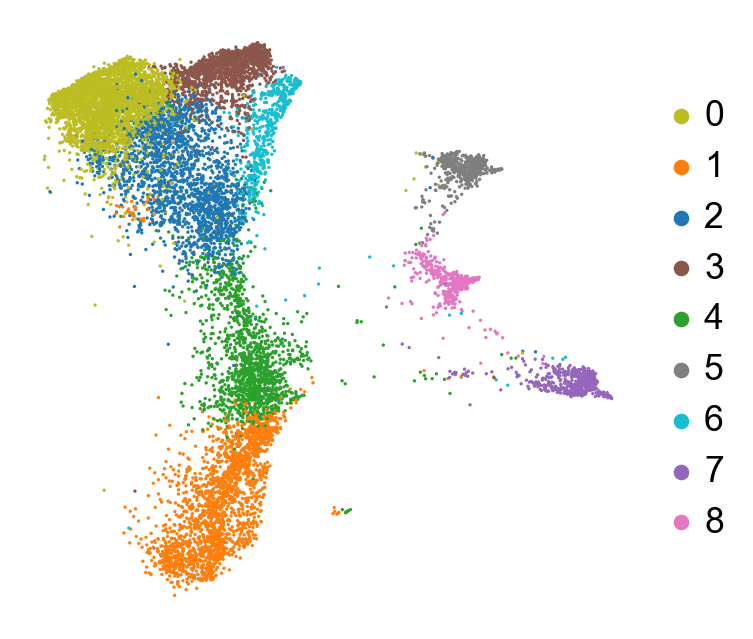

In [88]:
mypalette_sub = [mypalette[8],mypalette[1],mypalette[0],mypalette[5],mypalette[2],mypalette[7],mypalette[9],mypalette[4],mypalette[6],mypalette[9]];
plt.rcParams.update({'font.size':13})
plt.rcParams.update({'font.weight':'regular'})
sc.set_figure_params(figsize=[5,5])
sc.tl.leiden(adata_96, resolution=0.7, key_added='leiden_sub', random_state=0) # (0.7,0) 1,4
sc.pl.umap(
    adata_96,
    color=["leiden_sub"],
    frameon=False,
    ncols=5,
    title=[""],
    palette=mypalette_sub,#sb.color_palette('tab10', 10).copy(),
    legend_fontsize=16,
    #save='_96h_sub_leiden.png'
)

In [89]:
subclusterlabels = ['PM-LC','pluripotent','NasMe','LPM-LC','PS-LC','DE','CS-LC','AE-LC','PGC-LC']
adata_96.rename_categories('leiden_sub', subclusterlabels)

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1160: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  self.obs[key].cat.rename_categories(categories, inplace=True)


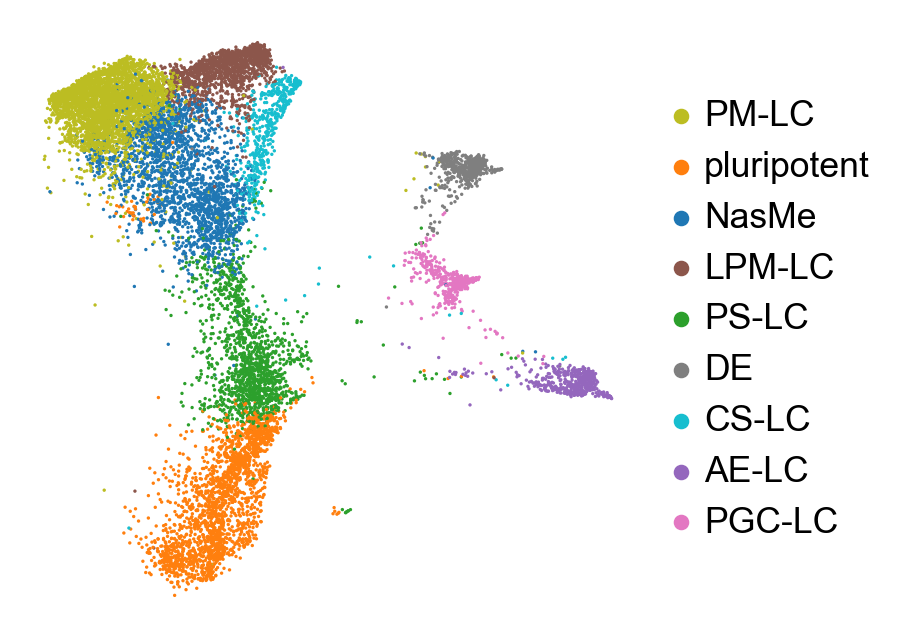

In [90]:
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    adata_96,
    color=["leiden_sub"],
    frameon=False,
    ncols=5,
    title=[""],
    palette=mypalette_sub,#sb.color_palette('tab10', 10).copy(),
    legend_fontsize=16,
    #save='_96h_sub_leiden_v2.png'
)

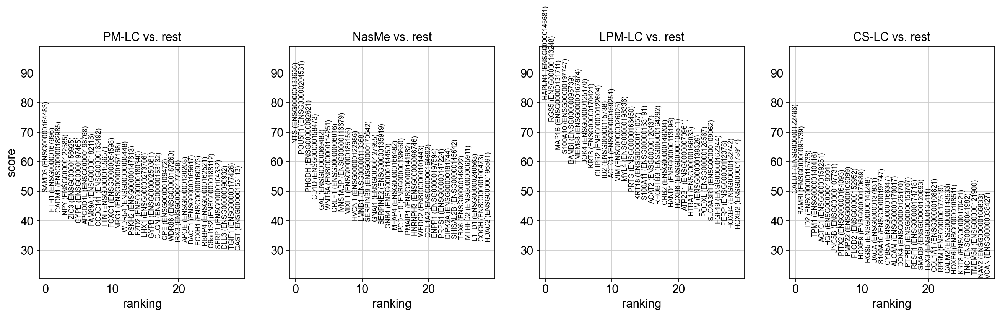

In [270]:
sc.tl.rank_genes_groups(adata_96_meso, groupby='leiden_sub', key_added='rank_leiden')#, method='wilcoxon')
sc.pl.rank_genes_groups(adata_96_meso, key='rank_leiden', fontsize=8, n_genes=30)

26


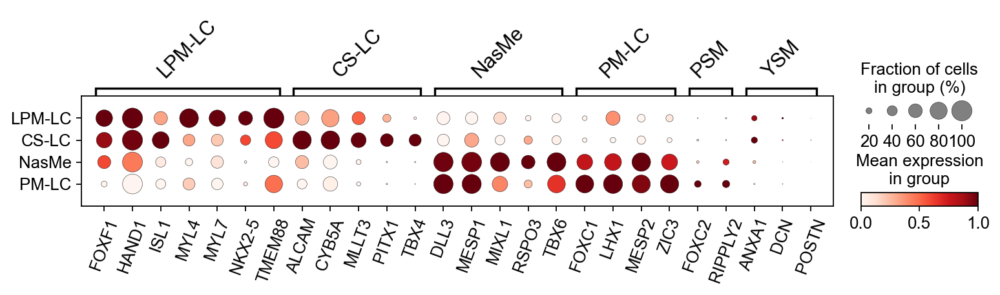

In [256]:
idx1 = np.logical_or(adata_96.obs['leiden_sub']==subclusterlabels[0],adata_96.obs['leiden_sub']==subclusterlabels[2])
idx2 = np.logical_or(adata_96.obs['leiden_sub']==subclusterlabels[3],adata_96.obs['leiden_sub']==subclusterlabels[6]);
idx3 = np.logical_or(idx1,idx2);

adata_96_meso = adata_96[idx3].copy();

Almarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['CYB5A','ALCAM','MLLT3','PITX1','TBX4']]; #,"WNT2"
ExMemarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['LUM','COL6A1','CALU','SPARC',"WNT5A","WNT5B","BAMBI"]]; #'POSTN',
LPMmarkers= [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['HAND1','TMEM88','FOXF1','NKX2-5','MYL4','MYL7','ISL1']]; #,"BMPER" 'HAPLN1','MSX1',
#pharmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ID4','ID1','ISL1']]
PSMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['FOXC2','RIPPLY2']] #'LFNG',
PMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['MESP2','LHX1',"ZIC3","FOXC1"]] # 'HES7','EVX1'
nasmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['TBX6','MIXL1','RSPO3',"MESP1","DLL3"]]#"MSGN1",
YSMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ["POSTN","DCN","ANXA1"]]

marker_genes_dict = {subclusterlabels[3]:LPMmarkers,
                     subclusterlabels[6]:Almarkers,
                     subclusterlabels[2]:nasmarkers,
                     subclusterlabels[0]:PMmarkers,
                     'PSM':PSMmarkers,
                    'YSM':YSMmarkers}



allmarkers=[];
for key in marker_genes_dict:
    allmarkers = allmarkers + marker_genes_dict[key]
print(len(allmarkers))
      
ax_dict = sc.pl.dotplot(adata_96_meso, marker_genes_dict, groupby='leiden_sub', dendrogram=False, 
                        categories_order=[subclusterlabels[3], subclusterlabels[6], subclusterlabels[2],subclusterlabels[0]],
                        show=False, standard_scale='var',var_group_rotation=45);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
plt.savefig(dataDir+'dotplot_mesomarkers_horizontal_v2.png',dpi=300, bbox_inches = "tight")
    
# ax_dict = sc.pl.dotplot(adata_all_ cc, marker_genes_dict, groupby='leiden', dendrogram=True, show=False, swap_axes=True);#, return_fig=True);
# ax_dict['mainplot_ax'].get_yticklabels();
# ax_dict['mainplot_ax'].set_yticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_yticklabels()]);
# plt.savefig(dataDir+'dotplot_markers_vertical.png',dpi=300, bbox_inches = "tight")

#dp = sc.pl.dotplot(adata, markers, 'bulk_labels', return_fig=True) 

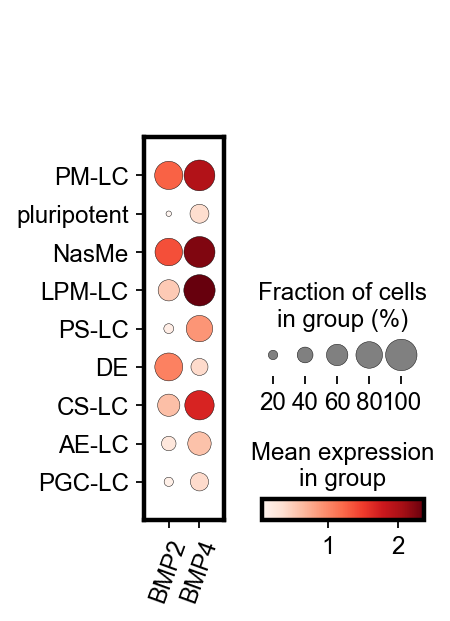

In [167]:
#genes_shortnames = [g.split()[0] for g in adata_96.raw.var_names if g.startswith("WNT")]
genes_shortnames = ['BMP2','BMP4']
genes_fullnames = [g for g in adata_96.raw.var_names if g.split()[0] in genes_shortnames];

ax_dict = sc.pl.dotplot(adata_96, genes_fullnames, groupby='leiden_sub', dendrogram=False,
                        show=False, #standard_scale='var',
                        var_group_rotation=45);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
plt.savefig(dataDir+'dotplot_signaling_96h.png',dpi=300, bbox_inches = "tight")
    
# ax_dict = sc.pl.dotplot(adata_all_ cc, marker_genes_dict, groupby='leiden', dendrogram=True, show=False, swap_axes=True);#, return_fig=True);
# ax_dict['mainplot_ax'].get_yticklabels();
# ax_dict['mainplot_ax'].set_yticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_yticklabels()]);
# plt.savefig(dataDir+'dotplot_markers_vertical.png',dpi=300, bbox_inches = "tight")

#dp = sc.pl.dotplot(adata, markers, 'bulk_labels', return_fig=True) 

In [263]:
#adata_96.write_h5ad(dataDir + 'adata_96h_v2.h5ad')

In [153]:
time = adata_all_cc.obs['sample_labels'].astype('str')
idx96h = np.logical_or(adata_all_cc.obs['sample_labels'] == '96h-1', adata_all_cc.obs['sample_labels'] == '96h-2')
time[idx96h] = '96h'
idx72h = np.logical_or(adata_all_cc.obs['sample_labels'] == '72h-1', adata_all_cc.obs['sample_labels'] == '72h-2')
time[idx72h] = '72h'
idx48h = np.logical_or(adata_all_cc.obs['sample_labels'] == '48h-1', adata_all_cc.obs['sample_labels'] == '48h-2')
time[idx48h] = '48h'
time = pd.Categorical(time);
adata_all_cc.obs['time'] = time;

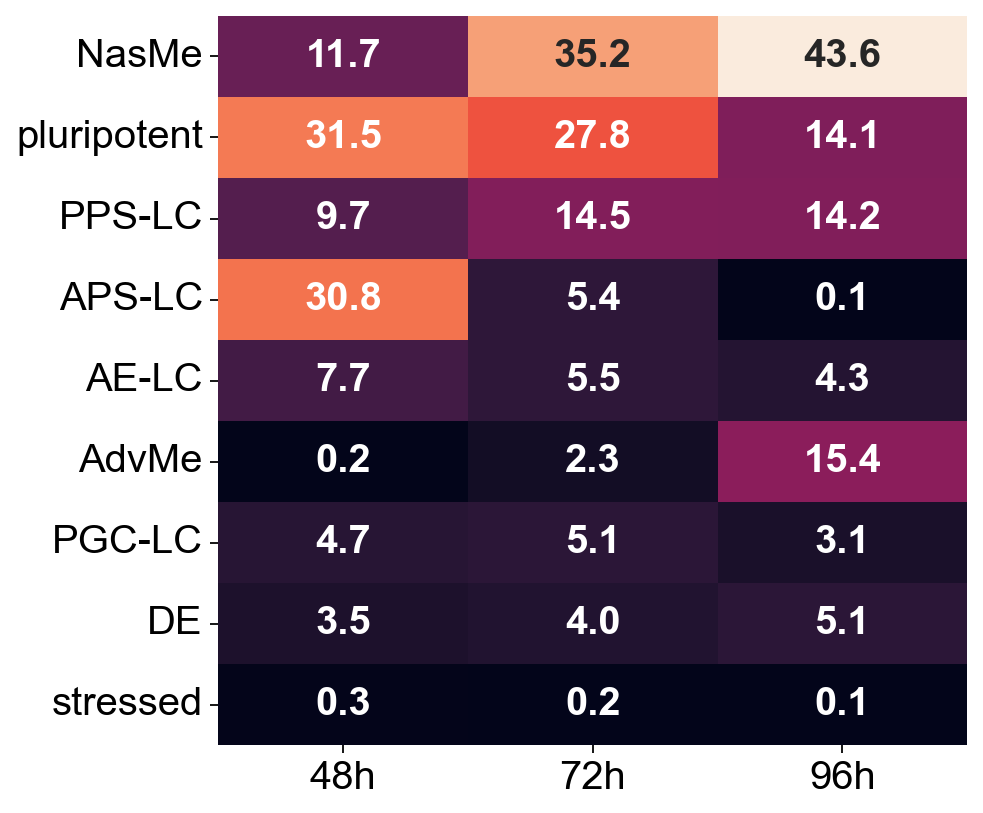

In [168]:
for group in ['time']:#, 'sample_labels'
    obs_tab = adata_all_cc.obs.copy()
    obs_summary = obs_tab.groupby(['leiden', group])[['_scvi_batch']].count()
    leiden_cell_count = obs_summary.groupby(group).transform(lambda x: x.sum())
    percentmap = obs_summary / leiden_cell_count * 100
    percentmap = percentmap.pivot_table(index='leiden', columns=group);
    percentmap.columns = [j for (i,j) in percentmap.columns];

    import seaborn as sns
    fs = 18;
    plt.figure(figsize=(6, 6))
    h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.1f')
    #h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
    h.set_xlabel('')
    h.set_ylabel('')
    for text in h.texts:
        text.set_fontweight('bold')
    for label in h.xaxis.get_ticklabels():
    #    label.set_fontweight('bold')
        label.set_fontsize(fs)
    for label in h.yaxis.get_ticklabels():
    #    label.set_fontweight('bold')
        label.set_fontsize(fs)
    plt.savefig(dataDir + 'heatmap_fatepercentageby'+group+'.png', bbox_inches='tight')

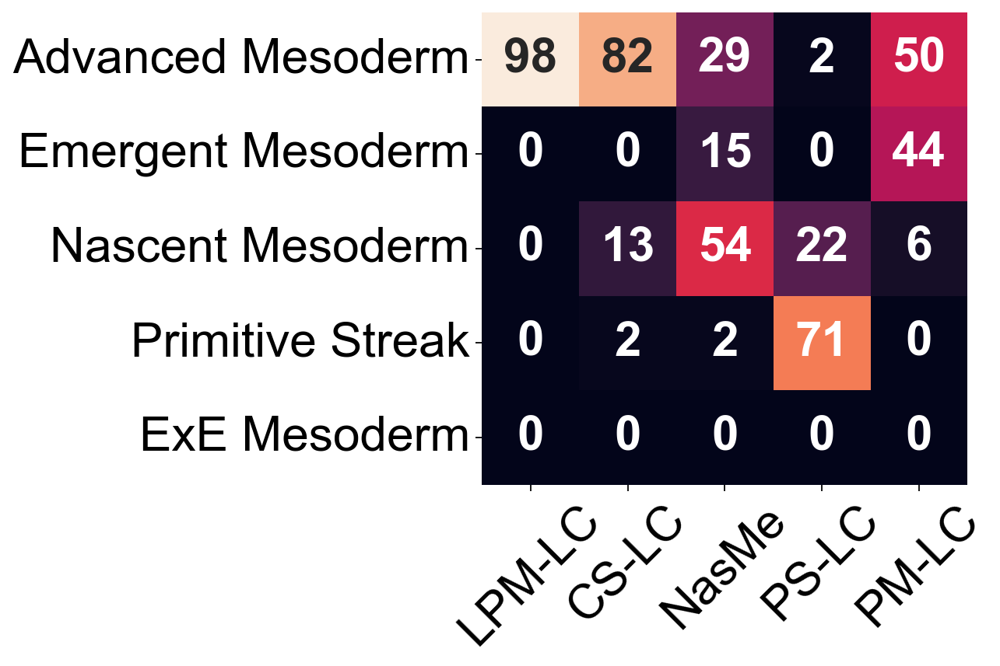

In [281]:
clustertype = 'leiden_sub';
predicttype = 'knnpred';#'knnpred_sub';
obs_tab = adata_full[adata_full.obs['batch'] == 'Query'].obs.copy()
obs_summary = obs_tab.groupby([clustertype,predicttype])[['time']].count() # time is just a random column without nan
leiden_cell_count = obs_summary.groupby(clustertype).transform(lambda x: x.sum())
percentmap = obs_summary / leiden_cell_count * 100
percentmap = percentmap.pivot_table(index=predicttype, columns=clustertype);
percentmap.columns = [j for (i,j) in percentmap.columns];

if clustertype == 'leiden':
    percentmap = percentmap[['AdvMe','NasMe','APS-LC','PPS-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
    colnames = ['AdvMe','NasMe','APS-LC','PPS-LC'];
else:
    percentmap = percentmap[['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
    colnames = ['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC'];
    
import seaborn as sns
fs = 28;
plt.figure(figsize=(5, 5))
h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.0f')
h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
h.set_xlabel('')
h.set_ylabel('')
for text in h.texts:
    text.set_fontweight('bold')
for label in h.xaxis.get_ticklabels():
#    label.set_fontweight('bold')
    label.set_fontsize(fs)
for label in h.yaxis.get_ticklabels():
#    label.set_fontweight('bold')
    label.set_fontsize(fs)
plt.savefig(dataDir + 'heatmap_'+clustertype + '_' + predicttype+'_v2.png', bbox_inches='tight')

## SCVI integration of gastrula and gastruloid

### Establish shared feature lists between datasets

In [60]:
adata_tyser = sc.read_h5ad(scseqDir + 'human_gastrula/tyser_craigmapped.h5ad')
adata2021 = sc.read_h5ad(scseqDir + '211113_ESI_MP48_72_96h scRNA data/adata_timeseries2021_487296.h5ad')
#adata2024 = anndata.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries2024_487296.h5ad')
adata2024 = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries2024_487296_v2.h5ad')

In [61]:
adata2021.obs['sample_labels'] = [g+'-1' for g in adata2021.obs['sample_labels']];
adata2024.obs['sample_labels'] = [g+'-2' for g in adata2024.obs['sample_labels']];

In [90]:
sharedfeat = list(set(adata2024.var_names).intersection(set(adata2021.var_names)));
adata_combined = adata2024[:,sharedfeat].concatenate(adata2021[:,sharedfeat]);

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [91]:
trimmedfeaturenames = [g.split()[0] for g in adata_combined.var_names];

In [92]:
sharedfeat = list(set(adata_tyser.var_names) & set(trimmedfeaturenames));
print(len(sharedfeat))

# define shared features as those that are not duplicated (to avoid ambiguity)
from collections import Counter
#counts = Counter(data_filt[conditions[0]].columns);
counts = Counter(adata_combined.var_names);
duplicatefeats = [key for key in counts.keys() if counts[key]>1]
sharedfeat = list(set(sharedfeat) - set(duplicatefeats));
print(len(sharedfeat))

13537
13537


In [93]:
adata_tyser_hvg = adata_tyser.copy();
sc.pp.highly_variable_genes(
    adata_tyser_hvg,
    n_top_genes=2000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
)
adata_tyser_hvg

AnnData object with n_obs × n_vars = 1184 × 2000
    obs: 'sub_cluster', 'cluster_id'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_id_colors', 'log1p', 'hvg'
    obsm: 'X_umap'
    layers: 'counts'

In [94]:
sharedhvg = list(set(adata_tyser_hvg.var_names) & set(trimmedfeaturenames));
adata_tyser_hvg = adata_tyser_hvg[:, sharedhvg].copy();

In [95]:
fullsharedfeaturenames = [g for g in adata_combined.var_names if g.split()[0] in sharedhvg];
len(fullsharedfeaturenames)

1338

In [96]:
gene_names = [g.split()[0] for g in fullsharedfeaturenames]
ensembol_ids = [g.split()[1] for g in fullsharedfeaturenames]
gene2ensembol = dict(zip(gene_names, ensembol_ids))
full_var_names = [g + ' ' + gene2ensembol[g] for g in adata_tyser_hvg.var_names]
adata_tyser_hvg.var_names = full_var_names;

In [97]:
adata_combined = adata_combined[:,fullsharedfeaturenames].copy();

In [287]:
# to prove that all genes are still there in .raw

print('TBXT' in sharedhvg)
print('SOX17' in sharedhvg)

mygenes = ['TBXT', 'SOX17'];

sc.pp.neighbors(adata_combined)
sc.tl.umap(adata_combined)

True
False
         Falling back to preprocessing with `sc.pp.pca` and default params.


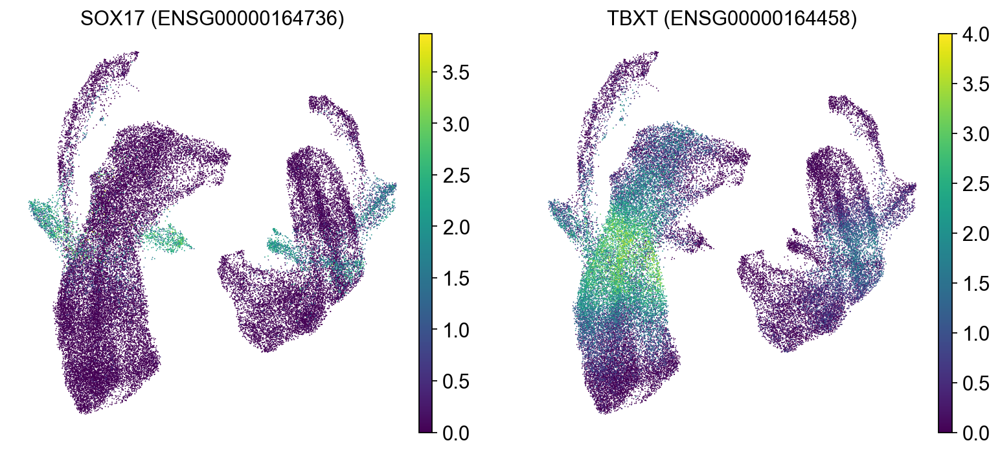

In [293]:
sc.pl.umap(
    adata_combined,
    use_raw=True,
    color=[g for g in adata_combined.raw.var_names if g.split()[0] in mygenes],
    frameon=False,
    ncols=2,
)

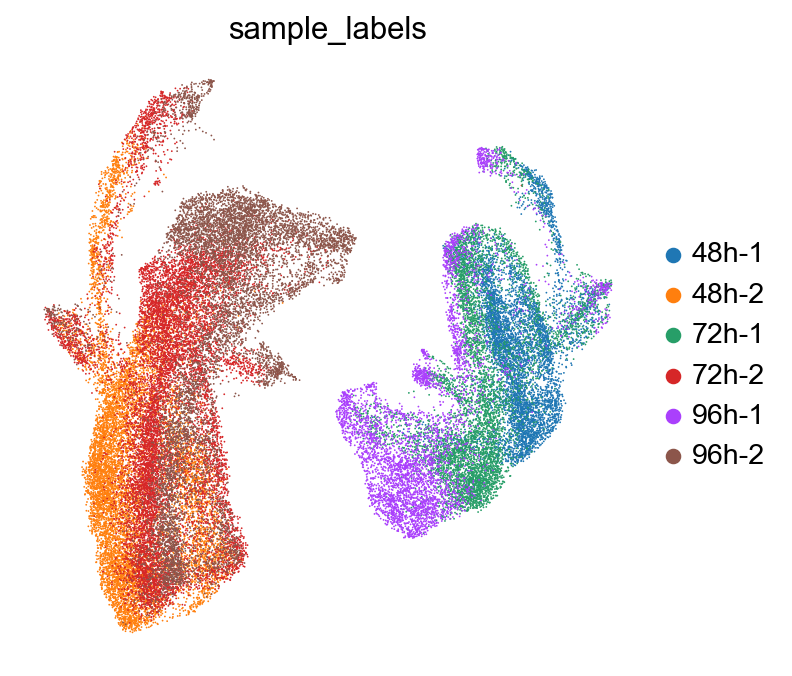

In [289]:
sc.pl.umap(
    adata_combined,
    use_raw=True,
    color=['sample_labels'],
    frameon=False,
    ncols=2,
)

### SCVI integration

In [137]:
adata_tyser_hvg = sc.read_h5ad(dataDir + '240229_adata_tyser_hvg.h5ad')

In [312]:
scvi.model.SCVI.setup_anndata(adata_tyser_hvg, layer="counts")

In [445]:
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    encode_covariates=True,
    dropout_rate=0.2,
    n_latent=20,
    n_layers=2,
)

vae_ref = scvi.model.SCVI(adata_tyser_hvg, **arches_params)
vae_ref.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (9) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 400/400: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [01:04<00:00,  6.23it/s, loss=1.06e+03, v_num=1]


In [138]:
# SAVE OR LOAD the reference model
dir_path = dataDir + "gastrula_model_240229_2/"
#vae_ref.save(dir_path, overwrite=True)
vae_ref = scvi.model.SCVI.load(dir_path, adata_tyser_hvg);

INFO     File /Users/idse/data_tmp/scRNAseq/240205_scRNAseq_0_48_72_96h_9704-BC/gastrula_mode
         l_240229_2/model.pt already downloaded                                              


In [151]:
adata_tyser_hvg.obsm["X_scVI"] = vae_ref.get_latent_representation()
sc.pp.neighbors(adata_tyser_hvg, use_rep="X_scVI")
sc.tl.leiden(adata_tyser_hvg)

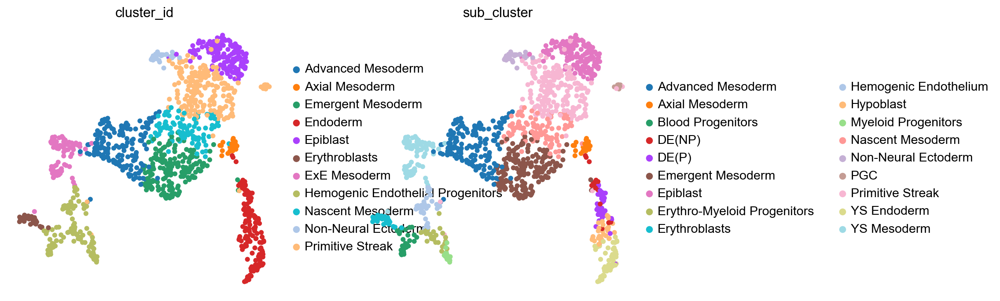

In [82]:
sc.tl.umap(adata_tyser_hvg, random_state=9) #1, 7 
sc.pl.umap(
    adata_tyser_hvg,
    color=['cluster_id','sub_cluster'],
    frameon=False,
    ncols=2,
)

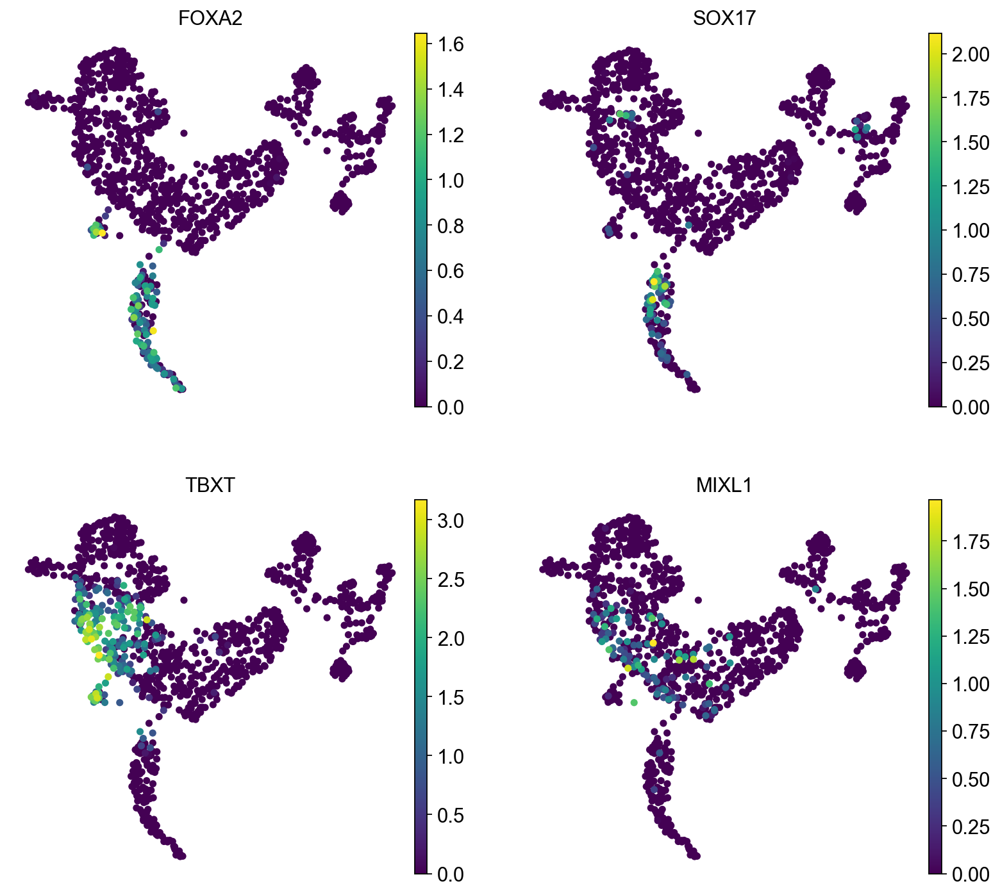

In [317]:
sc.pl.umap(
    adata_tyser_hvg,
    color=['FOXA2','SOX17','TBXT','MIXL1'],
    frameon=False,
    ncols=2,
)

In [456]:
# both are valid
#dir_path = "gastrula_model/"
#scvi.model.SCVI.prepare_query_anndata(adata_query, dir_path)
scvi.model.SCVI.prepare_query_anndata(adata_combined, vae_ref)

INFO     Found 100.0% reference vars in query data.                                          


In [457]:
# MAP GASTRULOIDS TO THE SAME SPACE AS GASTRULA
# create query model instance
vae_q = scvi.model.SCVI.load_query_data(
    adata_combined,
    vae_ref,
)

In [458]:
vae_q.train(max_epochs=200, plan_kwargs=dict(weight_decay=0.0))

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 200/200: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [14:21<00:00,  4.31s/it, loss=1.04e+03, v_num=1]


In [144]:
# reorder variables if necessary
adata_combined = adata_combined[:,adata_tyser_hvg.var_names].copy();

In [153]:
# save/load the reference model : NOT VALID
dir_path = dataDir + "gastruloid_all_query_model_240229/"
#vae_q.save(dir_path, overwrite=True)
vae_q = scvi.model.SCVI.load(dir_path, adata_combined);

INFO     File /Users/idse/data_tmp/scRNAseq/240205_scRNAseq_0_48_72_96h_9704-BC/gastruloid_al
         l_query_model_240229/model.pt already downloaded                                    


In [154]:
adata_combined.obsm["X_scVI"] = vae_q.get_latent_representation()

In [155]:
adata_full = adata_combined.concatenate(adata_tyser_hvg)
adata_full.obsm["X_scVI"] = vae_q.get_latent_representation(adata_full)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [156]:
sc.pp.neighbors(adata_full, use_rep="X_scVI")
#sc.tl.leiden(adata_full)
sc.tl.umap(adata_full)

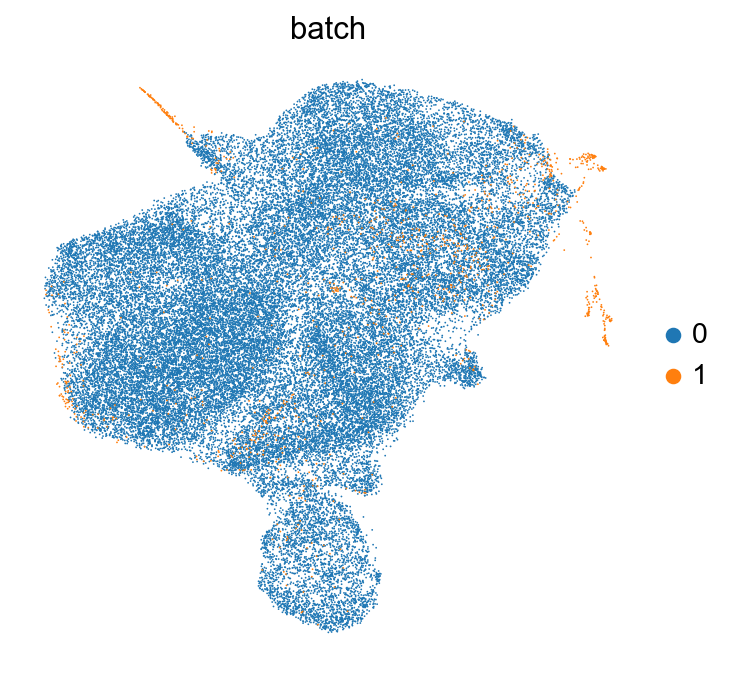

In [157]:
sc.pl.umap(
    adata_full,
    color=["batch"],
    frameon=False,
    ncols=3,
)

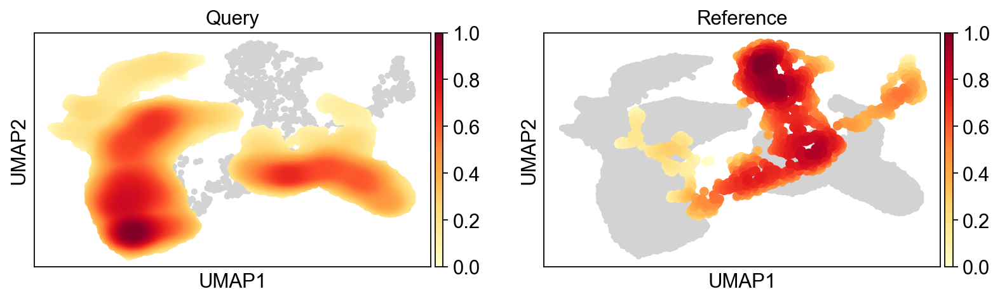

In [537]:
# # plot colored for density
# sc.tl.embedding_density(adata_full, basis='umap', groupby='batch')
# sc.pl.embedding_density(adata_full, basis='umap', key='umap_density_batch')

#### Map query to reference UMAP

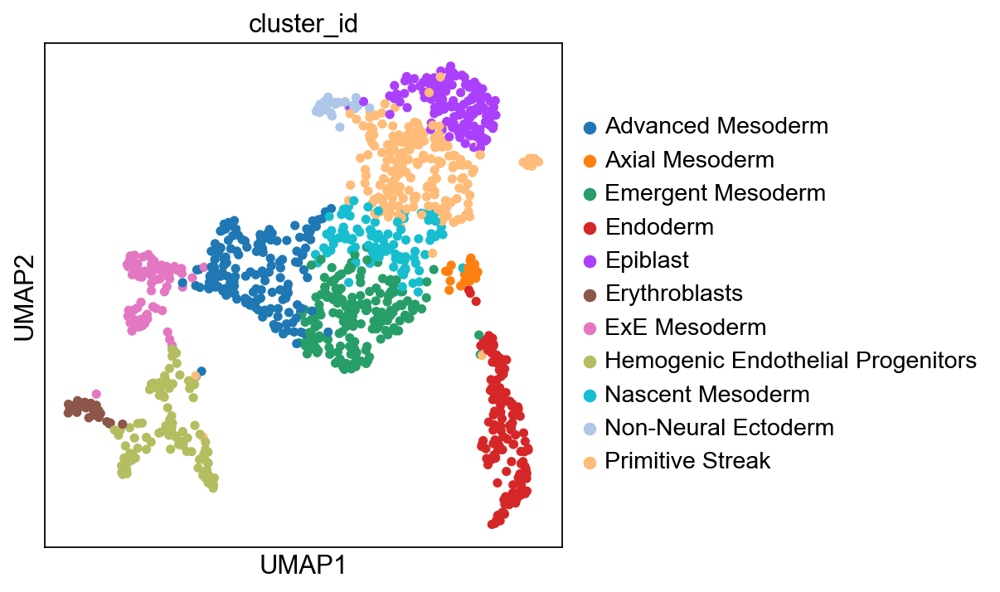

In [463]:
#sc.pp.neighbors(adata_tyser_hvg, use_rep="X_scVI")
sc.tl.umap(adata_tyser_hvg, random_state=9) #1,9, 13
sc.pl.umap(adata_tyser_hvg, color="cluster_id")

In [464]:
ref = adata_tyser_hvg.copy();
query = adata_combined.copy();

sc.tl.ingest(query, ref, embedding_method = 'umap')

In [465]:
adata_full = ref.concatenate(query)

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


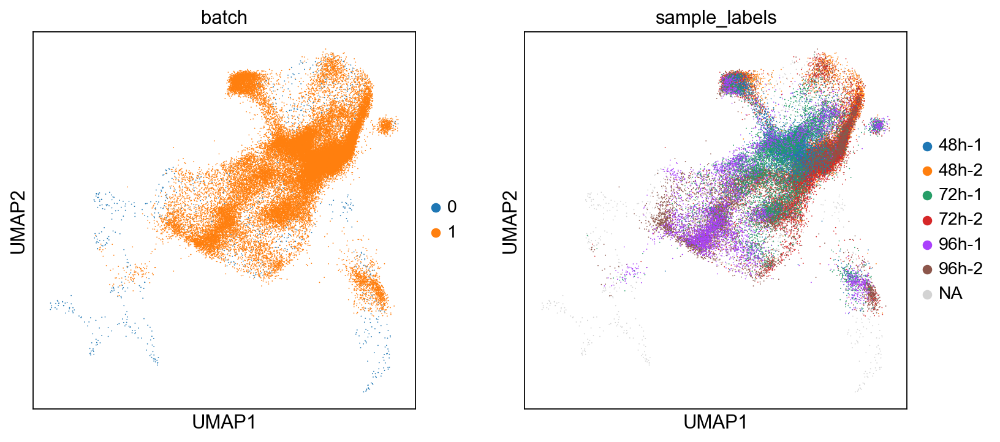

In [466]:
#sc.pp.neighbors(adata_full, use_rep="X_scVI")
#sc.tl.umap(adata_full)
sc.pl.umap(adata_full, color=["batch","sample_labels"])

### SCANVI label transfer

In [164]:
adata_tyser_hvg.obs["labels_scanvi"] = adata_tyser_hvg.obs["sub_cluster"].values

dir_path = dataDir + "gastrula_model_240229_2/"
vae_ref = scvi.model.SCVI.load(dir_path, adata_tyser_hvg);

vae_ref_scan = scvi.model.SCANVI.from_scvi_model(
    vae_ref,
    unlabeled_category="Unknown",
    labels_key="labels_scanvi",
)

INFO     File /Users/idse/data_tmp/scRNAseq/240205_scRNAseq_0_48_72_96h_9704-BC/gastrula_mode
         l_240229_2/model.pt already downloaded                                              


In [469]:
vae_ref_scan.train(max_epochs=20, n_samples_per_label=100)

INFO     Training for 20 epochs.                                                             


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (9) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 20/20: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.57it/s, loss=1.16e+03, v_num=1]


In [165]:
# # save the reference model
dir_path = dataDir +  "gastrula_model_240229_scan/" #23, 27_2,3
#vae_ref_scan.save(dir_path, overwrite=True)
vae_ref_scan = scvi.model.SCANVI.load(dir_path, adata_tyser_hvg)

INFO     File /Users/idse/data_tmp/scRNAseq/240205_scRNAseq_0_48_72_96h_9704-BC/gastrula_mode
         l_240229_scan/model.pt already downloaded                                           


In [160]:
adata_tyser_hvg.obsm["X_scANVI"] = vae_ref_scan.get_latent_representation()
sc.pp.neighbors(adata_tyser_hvg, use_rep="X_scANVI")

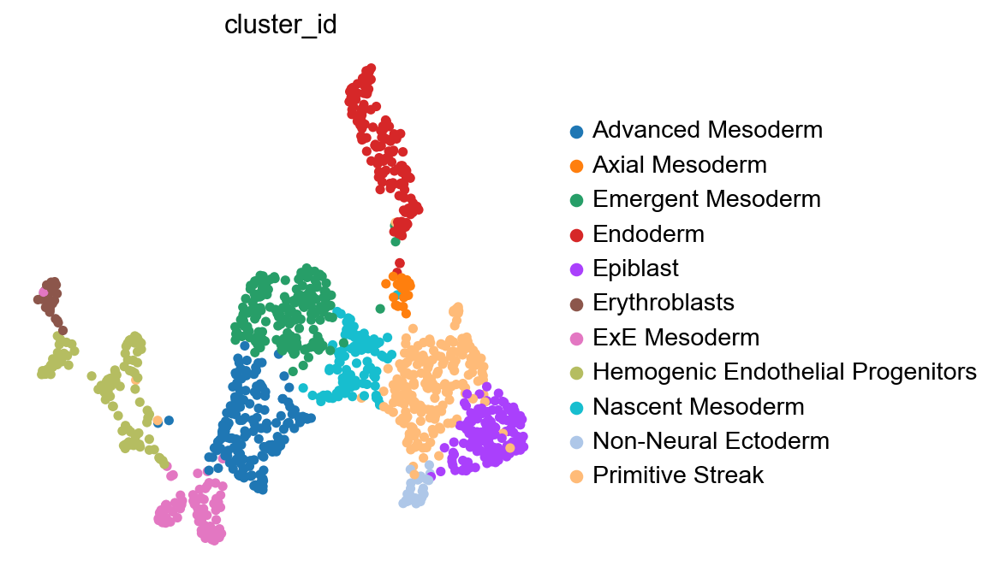

In [166]:
sc.tl.umap(adata_tyser_hvg, random_state=8) # 2,8
sc.pl.umap(
    adata_tyser_hvg,
    color=["cluster_id"],
    frameon=False,
    ncols=1,
)

In [167]:
#adata_tyser_hvg.write_h5ad(dataDir + '240302_adata_tyser_hvg.h5ad')

In [168]:
scvi.model.SCANVI.prepare_query_anndata(adata_combined, vae_ref_scan)

INFO     Found 100.0% reference vars in query data.                                          


In [169]:
#dir_path_scan = "gastrula_model_scanvi/"
vae_q = scvi.model.SCANVI.load_query_data(
    adata_combined,
    vae_ref_scan,
)

In [170]:
vae_q.train(
    max_epochs=100,
    plan_kwargs=dict(weight_decay=0.0),
    check_val_every_n_epoch=10,
)

INFO     Training for 100 epochs.                                                            


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 100/100: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [12:07<00:00,  7.28s/it, loss=1.04e+03, v_num=1]


In [171]:
dir_path_scan = "gastruloid_model_scanvi_240302/"
#vae_q.save(dir_path_scan, overwrite=True)

In [ ]:
# adata_combined.obs["predictions"][adata_combined.obs['batch']=='1'] = vae_q.predict()

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_20121/3923181960.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_combined.obs["predictions"][adata_combined.obs['batch']=='1'] = vae_q.predict()


In [172]:
adata_combined.obsm["X_scANVI"] = vae_q.get_latent_representation()
adata_combined.obs["predictions"] = vae_q.predict()

In [173]:
ref = adata_tyser_hvg.copy();
query = adata_combined.copy();

sc.tl.ingest(query, ref, embedding_method = 'umap')

In [174]:
#adata_combined.write_h5ad(dataDir + '240302_adata_combined_hvg.h5ad')

In [175]:
adata_tmp = query.concatenate(ref)

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


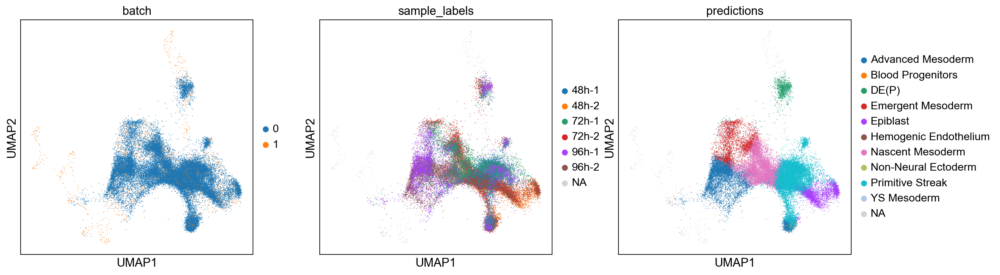

In [176]:
sc.pl.umap(adata_tmp, color=["batch","sample_labels",'predictions'])

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/scprep/plot/utils.py:104: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


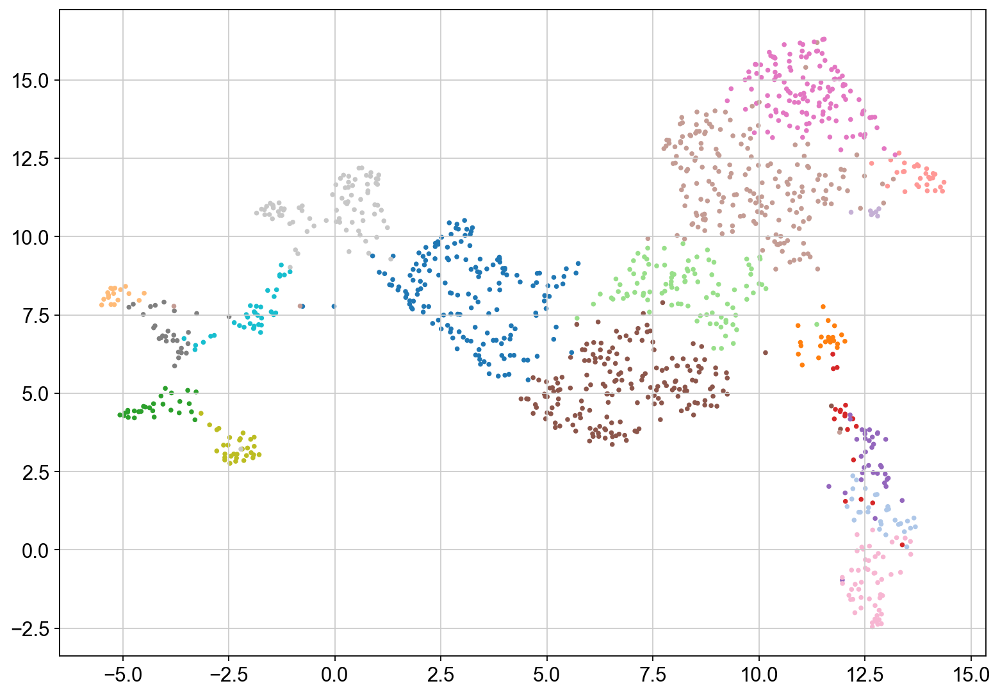

In [177]:
# run umap directly so we can map the reference first 4
#min_dist=0.5, spread=1.0, n_components=2, maxiter=None, alpha=1.0, negative_sample_rate=5, init_pos='spectral', random_state=0, a=None, b=None, copy=False, method='umap', neighbors_key=None
trans = umap.UMAP(n_neighbors=20, min_dist=0.5, spread=1.0, n_components=2, n_epochs=500, learning_rate=1.0, negative_sample_rate=5, init='spectral', random_state=0, a=None, b=None).fit(adata_tyser_hvg.obsm['X_scANVI'])
scprep.plot.scatter2d(trans.embedding_,c=adata_tyser_hvg.obs['sub_cluster'],figsize=(10,7),legend=False);

In [178]:
umap_query = trans.transform(adata_combined.obsm['X_scANVI'])

In [179]:
umap_combined = np.concatenate((umap_query,trans.embedding_), axis=0);

In [180]:
adata_combined.obs['gastruloid_clusters'] = adata_all_cc.obs['leiden'].to_numpy()

In [181]:
adata_full = adata_combined.concatenate(adata_tyser_hvg)
adata_full.obs.batch.cat.rename_categories(["Query", "Reference"], inplace=True)
adata_full.obsm['X_umap2'] = umap_combined;
adata_full.obsm['X_umap_ingest'] = adata_tmp.obsm['X_umap']

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_1459/3070933221.py:2: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  adata_full.obs.batch.cat.rename_categories(["Query", "Reference"], inplace=True)


/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


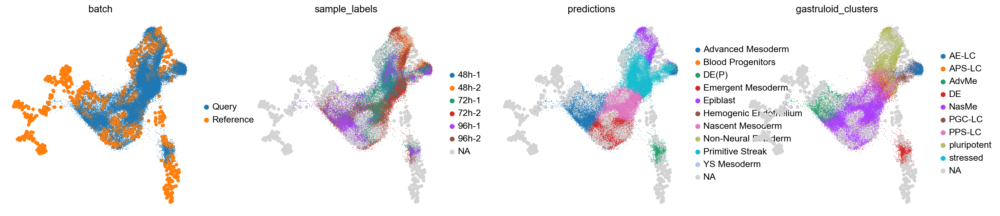

In [515]:
Nq = np.sum(adata_full.obs.batch == 'Query');
Nr = np.sum(adata_full.obs.batch == 'Reference');
index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

querysize = 120000 / Nq;
refsize = 120000 / Nr;
size = (adata_full.obs.batch == 'Query')*querysize + (adata_full.obs.batch == 'Reference')*refsize;

sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_full[index,:],
    basis='umap2',
    color=["batch","sample_labels","predictions","gastruloid_clusters"],
    size=size[index],
    frameon=False,
    ncols=4,
)

### scArches KNN label transfer

In [ ]:
# https://www.sc-best-practices.org/cellular_structure/annotation.html

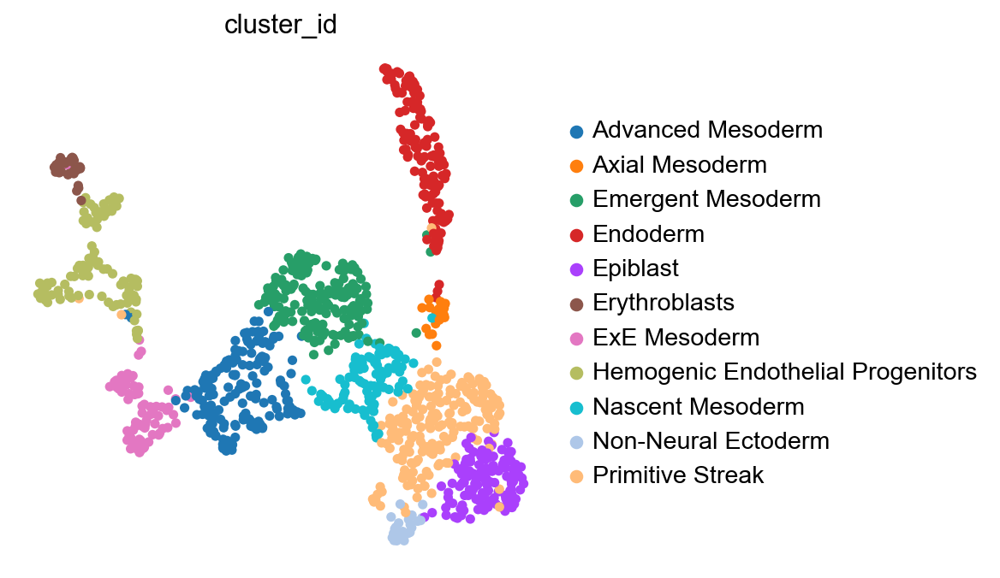

In [183]:
ref_emb = anndata.AnnData(adata_full[adata_full.obs['batch']=='Reference'].obsm['X_scANVI'],obs=adata_full[adata_full.obs['batch']=='Reference'].obs)
sc.pp.neighbors(ref_emb)
sc.tl.umap(ref_emb)
sc.pl.umap(
    ref_emb,
    color=["cluster_id"],
    sort_order=False,
    frameon=False,
)

In [184]:
emb_ref_query = anndata.AnnData(adata_full.obsm['X_scANVI'], adata_full.obs)
sc.pp.neighbors(emb_ref_query)
sc.tl.umap(emb_ref_query)

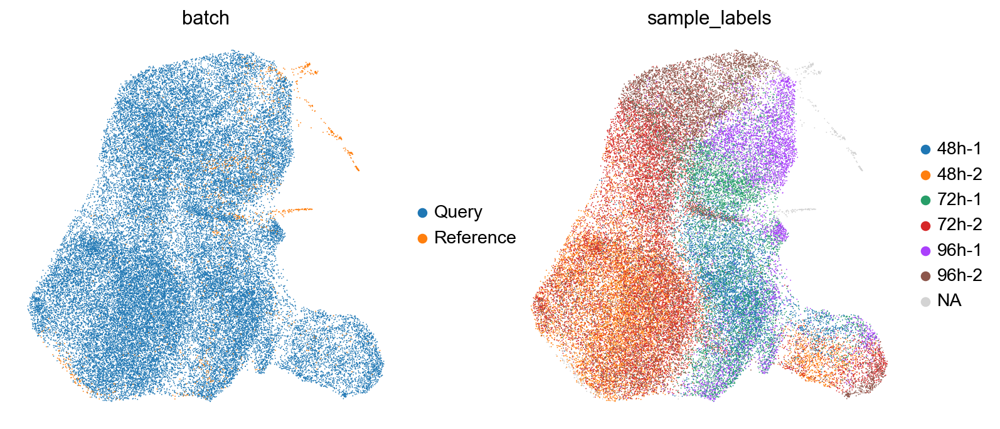

In [185]:
sc.pl.umap(
    emb_ref_query,
    color=["batch","sample_labels"],
    sort_order=False,
    frameon=False,
)

In [186]:
# https://www.sc-best-practices.org/cellular_structure/annotation.html
ref_emb.obs = ref_emb.obs.rename(columns={'sub_cluster':'cluster_sub'})
import scarches as sca
knn_transformer = sca.utils.knn.weighted_knn_trainer(
    train_adata=ref_emb,
    train_adata_emb="X",  # location of our joint embedding
    n_neighbors=15,
)

 captum (see https://github.com/pytorch/captum).


Weighted KNN with n_neighbors = 15 ... 

In [187]:
query_emb = anndata.AnnData(adata_full[adata_full.obs['batch']=='Query'].obsm['X_scANVI'],obs=adata_full[adata_full.obs['batch']=='Query'].obs)

In [188]:
labels, uncert = sca.utils.knn.weighted_knn_transfer(
    query_adata=query_emb,
    query_adata_emb="X",  # location of our embedding, query_adata.X in this case
    label_keys="cluster",  # (start of) obs column name(s) for which to transfer labels
    knn_model=knn_transformer,
    ref_adata_obs=ref_emb.obs,
)

finished!


In [189]:
query_emb.obs['knnpred_sub'] = labels.loc[query_emb.obs.index,"cluster_sub"]

In [190]:
query_emb.obs['knnpred'] = labels.loc[query_emb.obs.index,"cluster_id"]

In [191]:
adata_full.obs['knnpred_sub'] = adata_full.obs['predictions'].astype(str);
adata_full.obs['knnpred'] = adata_full.obs['predictions'].astype(str);

In [192]:
adata_full.obs['knnpred_sub'][adata_full.obs['batch']=='Query']= query_emb.obs['knnpred_sub']
adata_full.obs['knnpred'][adata_full.obs['batch']=='Query']= query_emb.obs['knnpred']

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_1459/3039289719.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_full.obs['knnpred_sub'][adata_full.obs['batch']=='Query']= query_emb.obs['knnpred_sub']
/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_1459/3039289719.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_full.obs['knnpred'][adata_full.obs['batch']=='Query']= query_emb.obs['knnpred']


/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


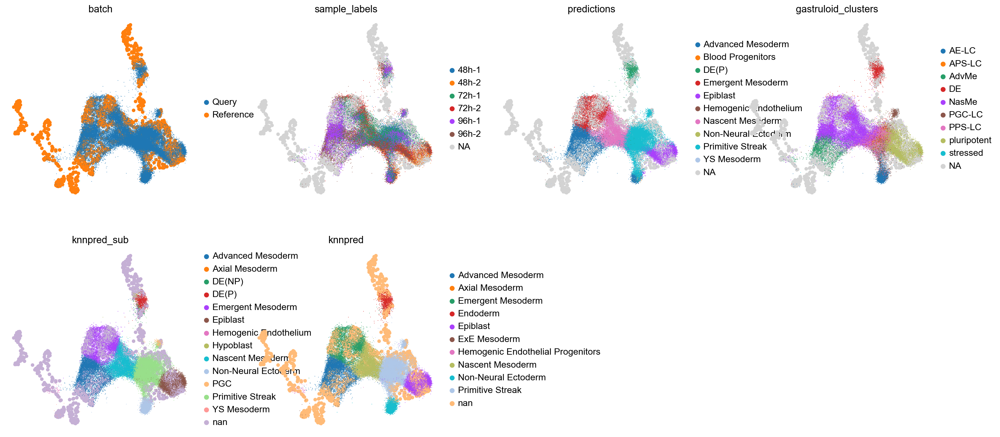

In [525]:
Nq = np.sum(adata_full.obs.batch == 'Query');
Nr = np.sum(adata_full.obs.batch == 'Reference');
index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

querysize = 120000 / Nq;
refsize = 120000 / Nr;
size = (adata_full.obs.batch == 'Query')*querysize + (adata_full.obs.batch == 'Reference')*refsize;

sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_full[index,:],
    basis='X_umap_ingest',
    color=["batch","sample_labels","predictions","gastruloid_clusters",'knnpred_sub','knnpred'],
    size=size[index],
    frameon=False,
    ncols=4,
)

In [194]:
adata_full.write_h5ad(dataDir+'240302_tyser_allgastruloid_scanvi.h5ad')

In [46]:
#adata_full = sc.read_h5ad(dataDir+'240302_tyser_allgastruloid_scanvi.h5ad')

### Figures for paper

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


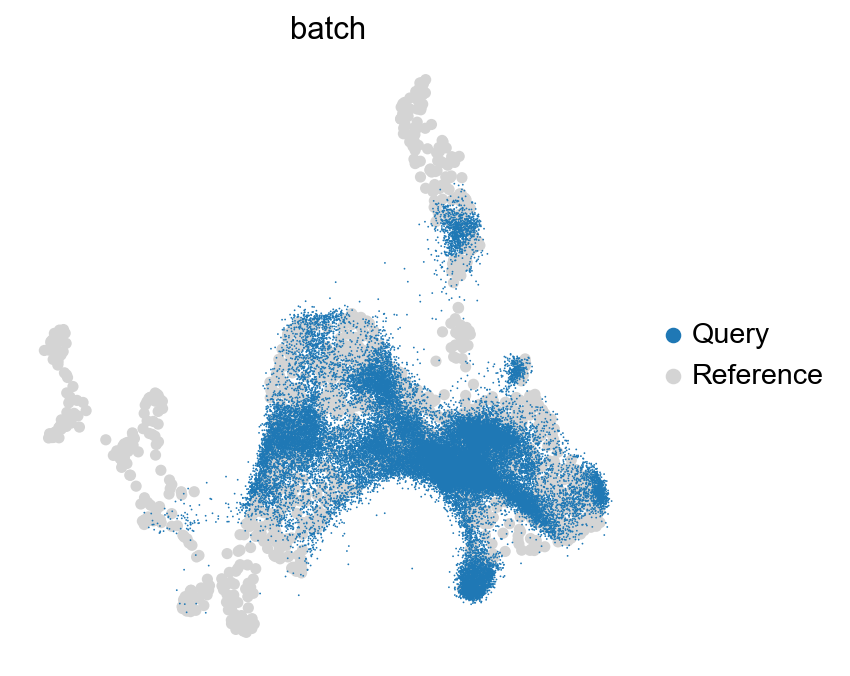

In [195]:
sc.settings.figdir = dataDir

Nq = np.sum(adata_full.obs.batch == 'Query');
Nr = np.sum(adata_full.obs.batch == 'Reference');
index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

querysize = 120000 / Nq;
refsize = 120000 / Nr;
size = (adata_full.obs.batch == 'Query')*querysize + (adata_full.obs.batch == 'Reference')*refsize;
mybasis = 'X_umap_ingest';

sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_full[index,:],
    basis=mybasis,
    color=["batch"],
    size=size[index],
    palette=[(0.12,0.47,0.71),(0.83,0.83,0.83)],
    frameon=False,
    ncols=2,
    #save='_gastrula_gastruloid_all_sample_overlay.png',
)

In [196]:
time = adata_full.obs['sample_labels'].astype('str')
time[adata_full.obs['batch']=='Reference']='CS7'
idx96h = np.logical_or(adata_full.obs['sample_labels'] == '96h-1', adata_full.obs['sample_labels'] == '96h-2')
time[idx96h] = '96h'
idx72h = np.logical_or(adata_full.obs['sample_labels'] == '72h-1', adata_full.obs['sample_labels'] == '72h-2')
time[idx72h] = '72h'
idx48h = np.logical_or(adata_full.obs['sample_labels'] == '48h-1', adata_full.obs['sample_labels'] == '48h-2')
time[idx48h] = '48h'
time = pd.Categorical(time);
adata_full.obs['time'] = time;

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


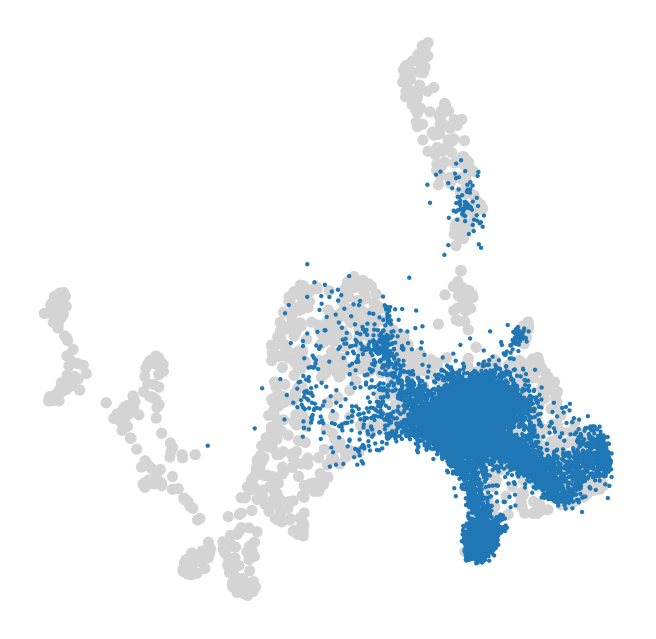

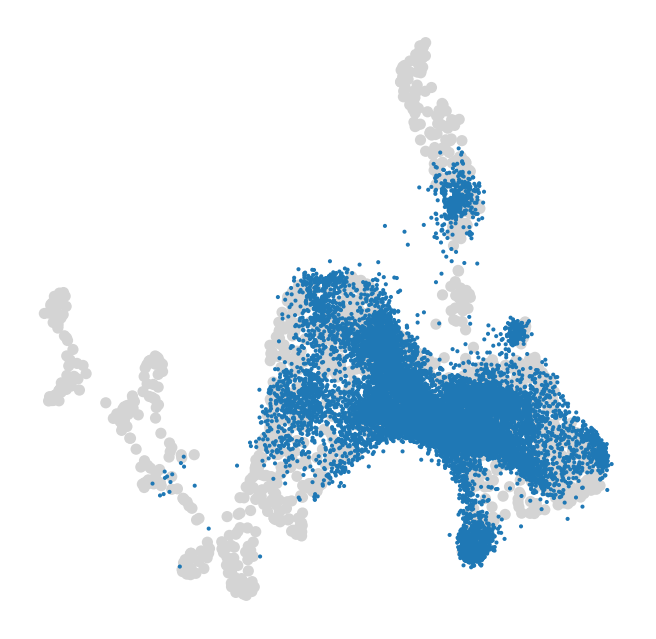

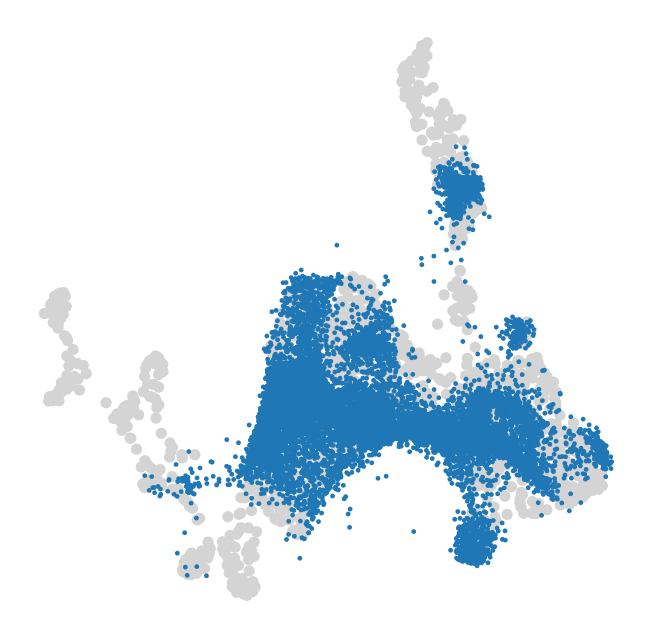

In [231]:
for time in ['48h','72h','96h']:

    subidx = np.logical_or(adata_full.obs['time'] == time, adata_full.obs['time'] == 'CS7');

    Nq = np.sum(adata_full[subidx].obs.batch == 'Query');
    Nr = np.sum(adata_full[subidx].obs.batch == 'Reference');
    index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

    querysize = 120000 / Nq;
    refsize = 120000 / Nr;
    size = (adata_full[subidx].obs.batch == 'Query')*querysize + (adata_full[subidx].obs.batch == 'Reference')*refsize;

    sc.set_figure_params(figsize=[5,5])
    fig = sc.pl.embedding(
        adata_full[subidx][index,:],
        basis=mybasis,
        color=["time"],
        size=size[index],
        frameon=False,
        palette=[(0.12,0.47,0.71),(0.83,0.83,0.83)],
        ncols=2,
        title=[""],
        return_fig=True,
    )
    fig.axes[0].get_legend().remove()
    plt.savefig(dataDir+'umap2_gastrula_gastruloid_all_sample_overlay_'+ time +'.png')

/Users/idse/opt/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


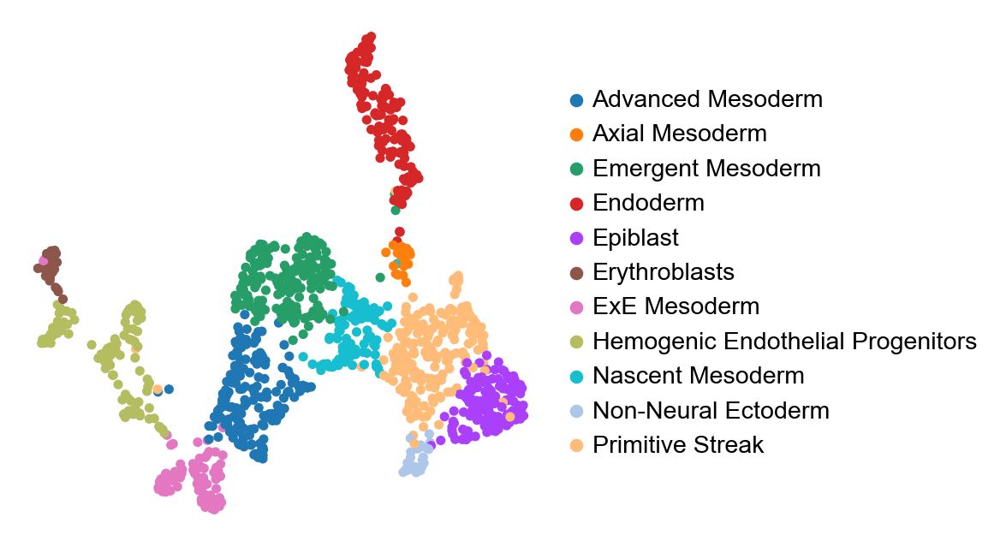

In [531]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_full[adata_full.obs['time'] == 'CS7'],
    basis=mybasis,
    color=["cluster_id"],
    frameon=False,
    title=[""],
    ncols=2,
    save='gastrula_cluster.png'
)

In [199]:
adata_full.obs['leiden'] = float('nan')
adata_full.obs['leiden'][adata_full.obs['batch']=='Query'] = adata_all_cc.obs['leiden'].to_numpy()

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_1459/3720191829.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_full.obs['leiden'][adata_full.obs['batch']=='Query'] = adata_all_cc.obs['leiden'].to_numpy()


In [200]:
#adata_full.write_h5ad(dataDir+'240302_tyser_allgastruloid_scanvi.h5ad')

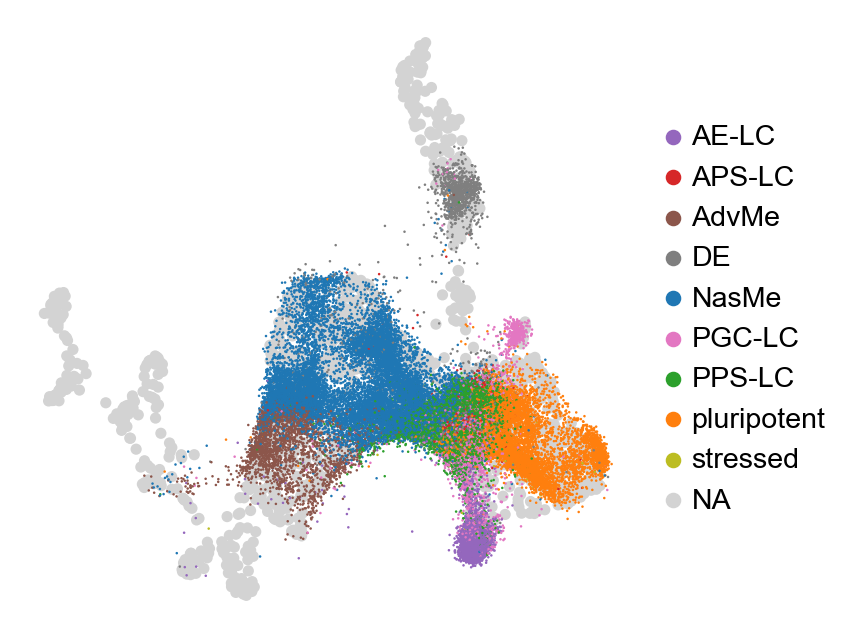

In [229]:
Nq = np.sum(adata_full.obs.batch == 'Query');
Nr = np.sum(adata_full.obs.batch == 'Reference');
index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

querysize = 2*120000 / Nq;
refsize = 120000 / Nr;
size = (adata_full.obs.batch == 'Query')*querysize + (adata_full.obs.batch == 'Reference')*refsize;

mypalette2 = [mypalette[0],mypalette[1],mypalette[2],mypalette[3],mypalette[4],mypalette[5],mypalette[6],mypalette[7],mypalette[8],mypalette[9]];
mypalette2 = [mypalette[4],mypalette[3],mypalette[5],mypalette[7],mypalette[0],mypalette[6],mypalette[2],mypalette[1],mypalette[8],mypalette[9]];

sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_full,
    basis=mybasis,
    color=["leiden"],
    frameon=False,
    size=size,
    title=[""],
    palette=mypalette2,
    ncols=2,
    save='gastruloid_clusters_on_gastrula.png'
)

In [215]:
adata_96

AnnData object with n_obs × n_vars = 13060 × 963
    obs: 'sample_labels', 'HMMR (ENSG00000072571)', 'GADD45A (ENSG00000116717)', 'BUB1 (ENSG00000169679)', 'TFAP2A (ENSG00000137203)', 'DLGAP5 (ENSG00000126787)', 'SFPQ (ENSG00000116560)', 'CENPA (ENSG00000115163)', 'ARL6IP1 (ENSG00000170540)', 'RHOBTB3 (ENSG00000164292)', 'TUBB4B (ENSG00000188229)', 'HIST1H2AC (ENSG00000180573)', 'CFLAR (ENSG00000003402)', 'NEK2 (ENSG00000117650)', 'UBE2C (ENSG00000175063)', 'CALM2 (ENSG00000143933)', 'HMGB2 (ENSG00000164104)', 'KLF6 (ENSG00000067082)', 'CALD1 (ENSG00000122786)', 'CDK1 (ENSG00000170312)', 'GAS1 (ENSG00000180447)', 'RBM8A (ENSG00000265241)', 'HIST1H4C (ENSG00000197061)', 'MKI67 (ENSG00000148773)', 'KIF23 (ENSG00000137807)', 'AURKA (ENSG00000087586)', 'KPNA2 (ENSG00000182481)', 'GCLM (ENSG00000023909)', 'HJURP (ENSG00000123485)', 'CENPE (ENSG00000138778)', 'TUBA1A (ENSG00000167552)', 'TOP2A (ENSG00000131747)', 'PLK1 (ENSG00000166851)', 'DEPDC1 (ENSG00000024526)', 'FAM83D (ENSG00000101447)

In [216]:
adata_full.obs['leiden_sub'] = float('nan')
adata_full.obs['leiden_sub'][adata_full.obs['time']=='96h'] = adata_96.obs['leiden_sub'].to_numpy()

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_1459/2071457052.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_full.obs['leiden_sub'][adata_full.obs['time']=='96h'] = adata_96.obs['leiden_sub'].to_numpy()


In [218]:
#adata_full.write_h5ad(dataDir+'240302_tyser_allgastruloid_scanvi.h5ad')

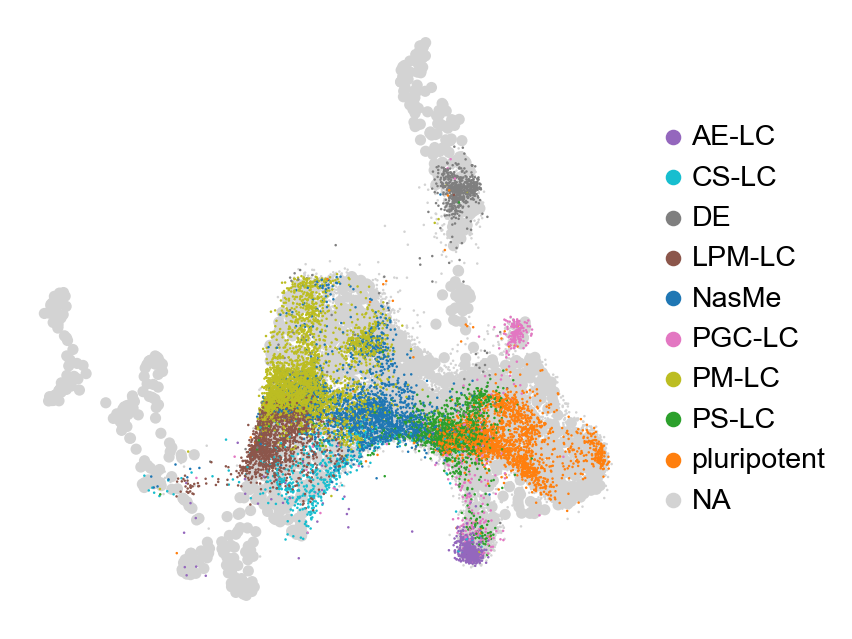

In [272]:
Nq = np.sum(adata_full.obs.batch == 'Query');
Nr = np.sum(adata_full.obs.batch == 'Reference');
index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

querysize = 2*120000 / Nq;
refsize = 120000 / Nr;
size = (adata_full.obs.batch == 'Query')*querysize + (adata_full.obs.batch == 'Reference')*refsize;

mypalette2 = mypalette_sub;
mypalette2 = [mypalette2[7],mypalette2[6],mypalette2[5],mypalette2[3],mypalette2[2],mypalette2[8],mypalette2[0],mypalette2[4],mypalette2[1],mypalette2[1]];

mybasis = 'X_umap_ingest';

sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_full,
    basis=mybasis,
    color=["leiden_sub"],
    frameon=False,
    size=size,
    title=[""],
    palette=mypalette2,
    ncols=2,
    save='gastruloid_subclusters_on_gastrula.png'
)

In [290]:
adata_tyser_hvg.raw.var_names

Index(['WASH7P', 'MIR1302-2HG', 'ENSG00000241860', 'WASH9P', 'ENSG00000228463',
       'ENSG00000237094', 'ENSG00000230021', 'MTND1P23', 'MTND2P28',
       'MTCO1P12',
       ...
       'MT-TT', 'MT-TP', 'ENSG00000276256', 'ENSG00000273748',
       'ENSG00000271254', 'ENSG00000276345', 'ENSG00000278673',
       'ENSG00000273554', 'ENSG00000278817', 'ENSG00000277196'],
      dtype='object', length=21080)

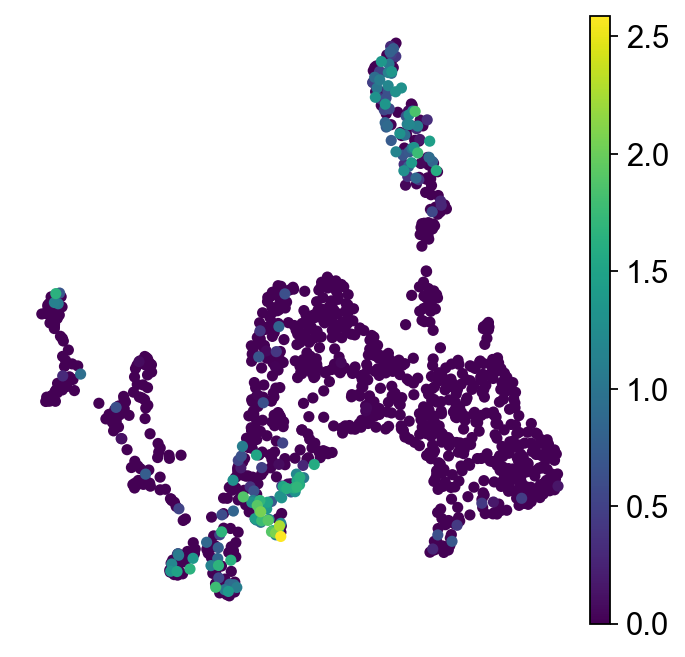

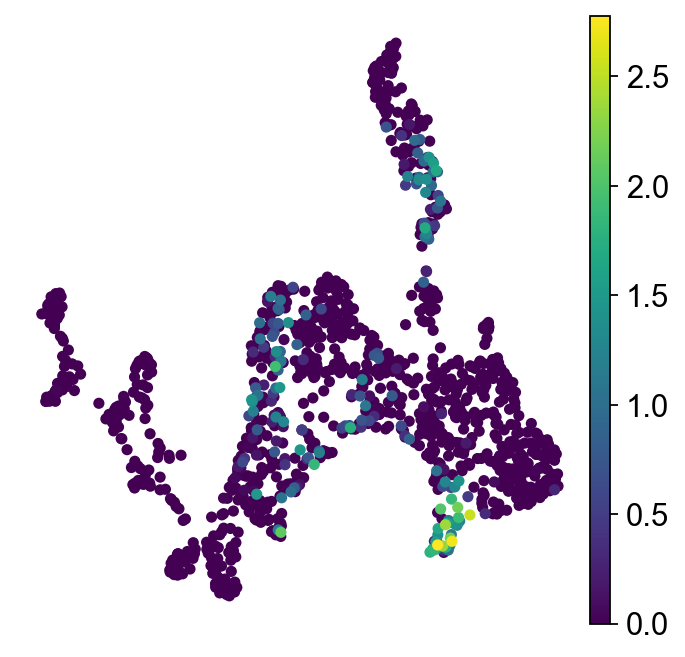

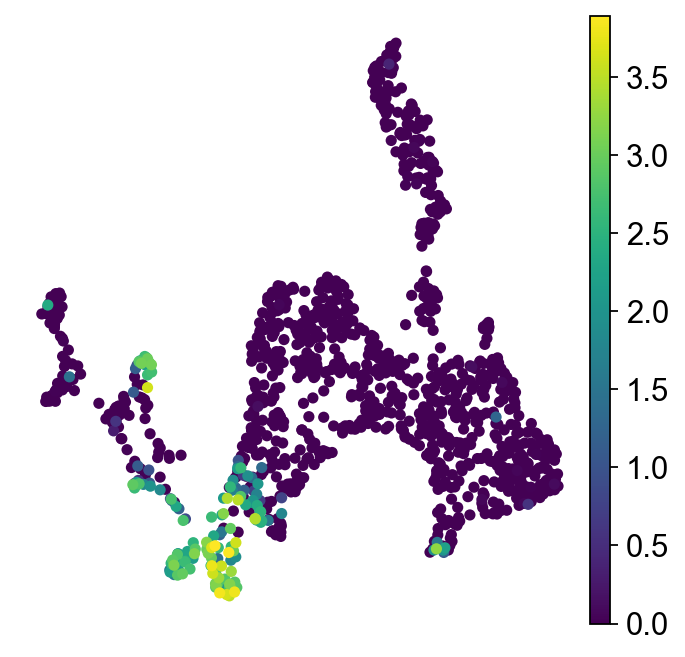

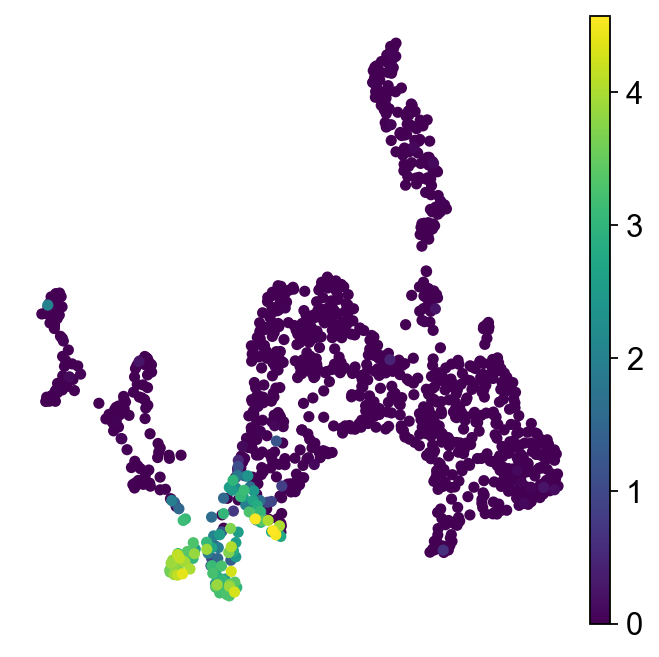

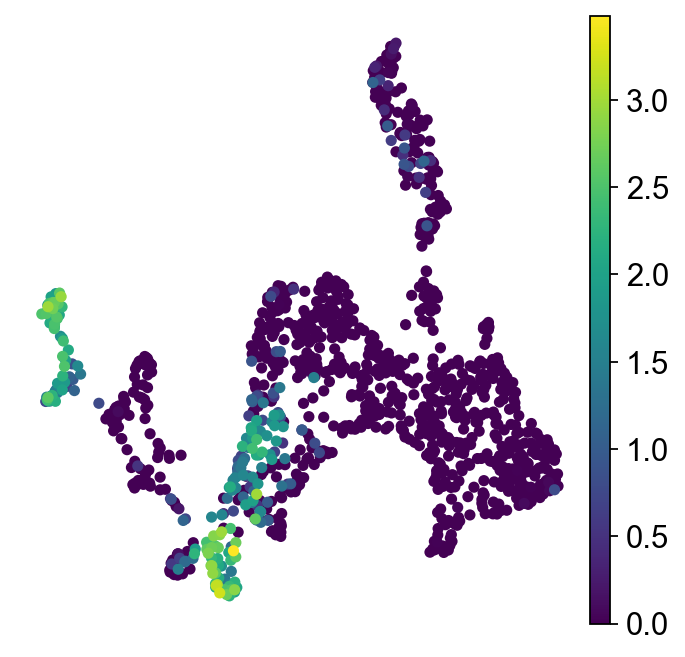

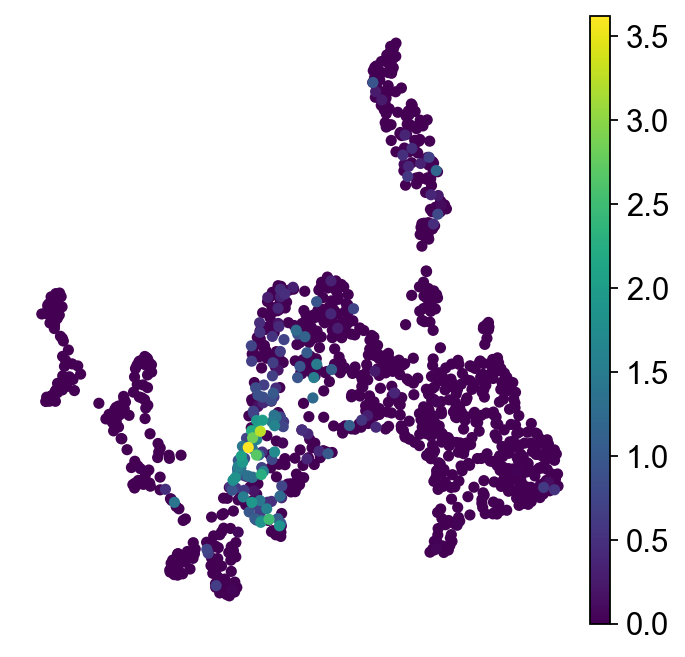

In [294]:
mygenes = ["PITX1","ISL1","ANXA1","DCN","MYL4","MYL7"];
mygenes_fullname = [g for g in adata_combined.raw.var_names if g.split()[0] in mygenes];
mybasis = 'X_umap_ingest';

sc.set_figure_params(figsize=[5,5])
for i in range(0,len(mygenes)):
    sc.pl.embedding(
        adata_tyser_hvg,
        use_raw=True,
        basis='X_umap',
        color=[mygenes[i]],
        frameon=False,
        title=[""],
        ncols=2,
        save='gastrula_'+ mygenes[i] +'.png'
    )

In [51]:
adata_tyser_hvg = sc.read_h5ad(dataDir + '240229_adata_tyser_hvg.h5ad')
data_tyser_hvg = pd.DataFrame(adata_tyser_hvg.raw.X, index=adata_tyser_hvg.obs.index, columns=adata_tyser_hvg.raw.var_names);

In [52]:
data_tyser_hvg_magic = magic.MAGIC(knn=5,t=1).fit_transform(data_tyser_hvg)

Calculating MAGIC...
  Running MAGIC on 1184 cells and 21080 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.44 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.15 seconds.
    Calculating affinities...
    Calculated affinities in 0.15 seconds.
  Calculated graph and diffusion operator in 0.76 seconds.
  Running MAGIC with `solver='exact'` on 21080-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 0.23 seconds.
Calculated MAGIC in 1.04 seconds.


In [53]:
adata_tyser_hvg_magic = anndata.AnnData(data_tyser_hvg_magic)
adata_tyser_hvg_magic.obs = adata_tyser_hvg.obs;
adata_tyser_hvg_magic.obsm = adata_tyser_hvg.obsm;

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_12712/1522526056.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_tyser_hvg_magic = anndata.AnnData(data_tyser_hvg_magic)


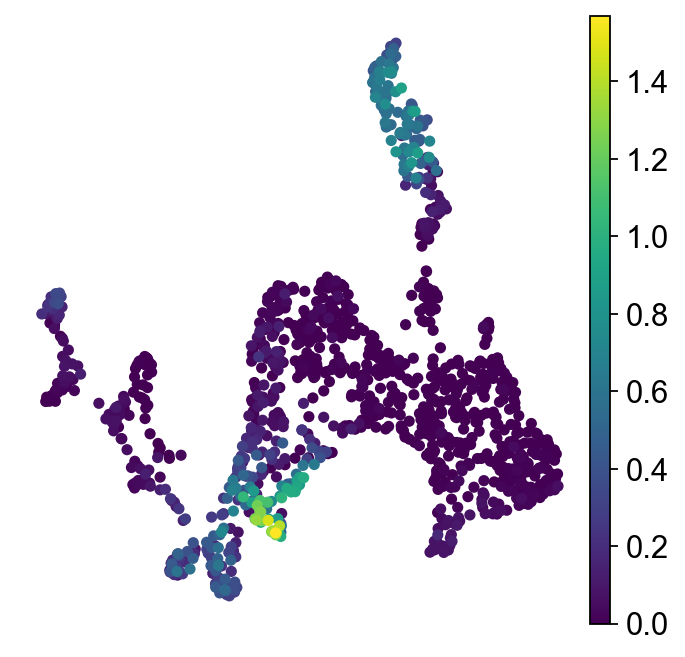

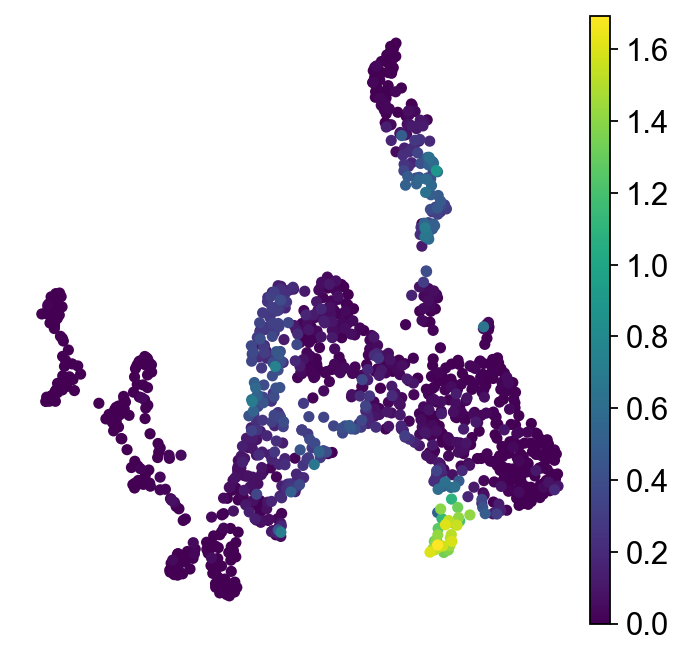

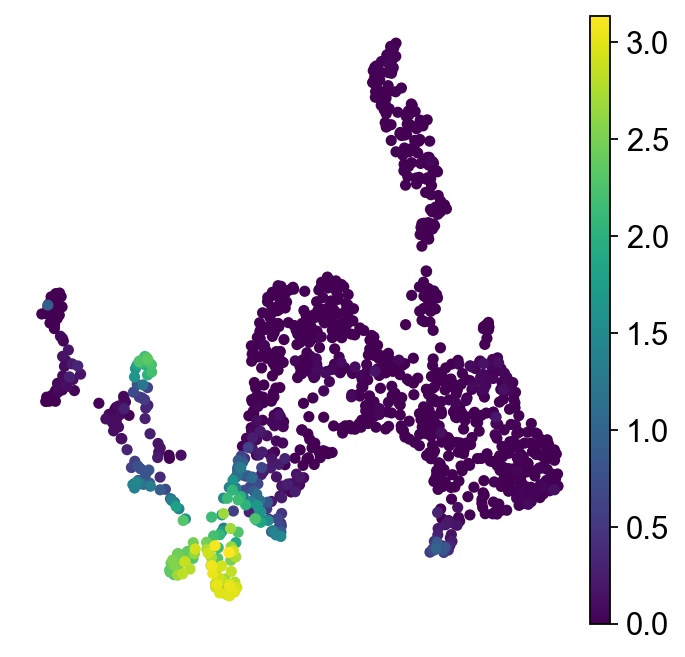

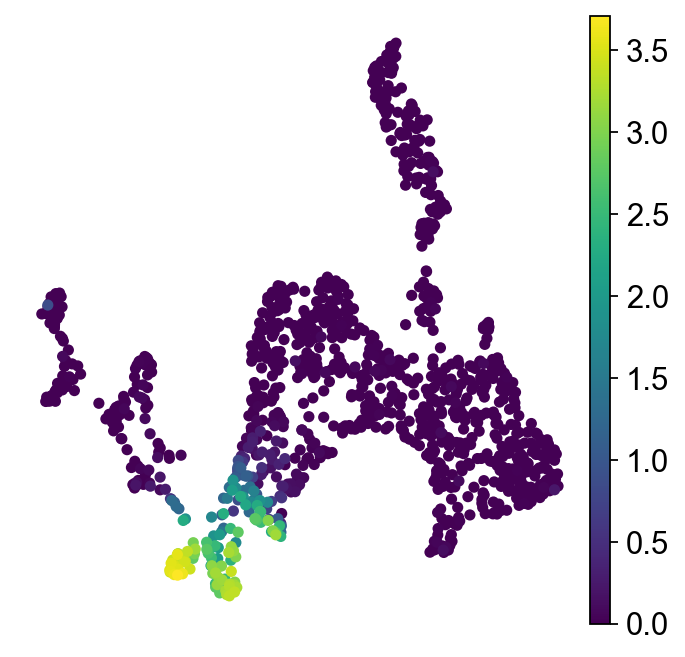

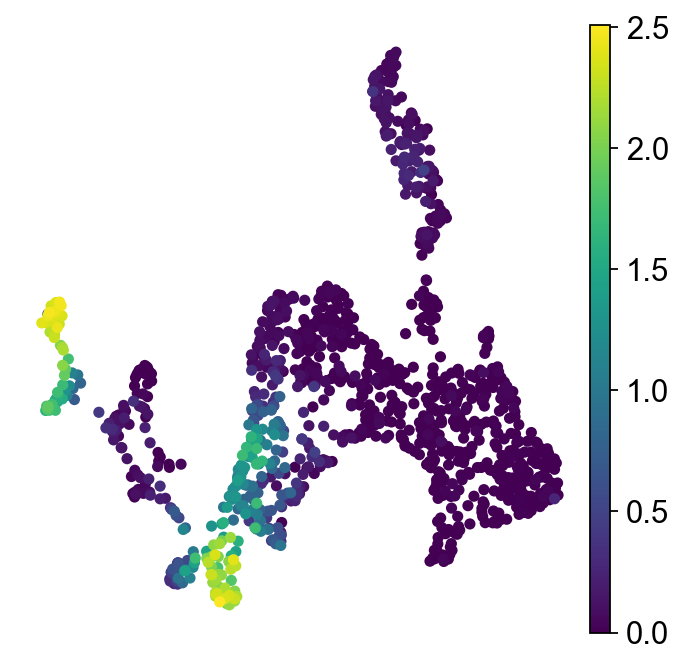

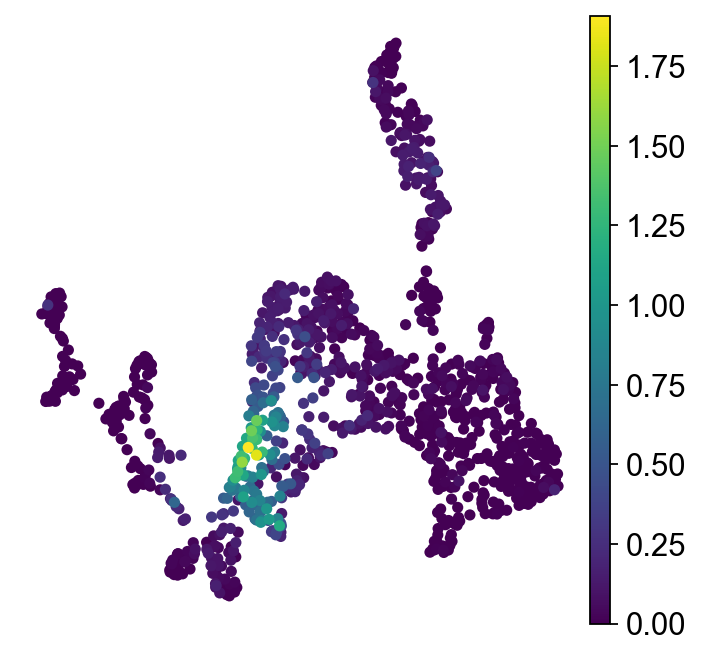

In [54]:
mygenes = ["PITX1","ISL1","ANXA1","DCN","MYL4","MYL7"];
mygenes_fullname = [g for g in adata_tyser_hvg.raw.var_names if g.split()[0] in mygenes];
mybasis = 'X_umap_ingest';

sc.set_figure_params(figsize=[5,5])
for i in range(0,len(mygenes)):
    sc.pl.embedding(
        adata_tyser_hvg_magic,
        use_raw=False,
        basis='X_umap',
        color=[mygenes[i]],
        frameon=False,
        title=[""],
        ncols=2,
        save='gastrula_'+ mygenes[i] +'_magic.png'
    )

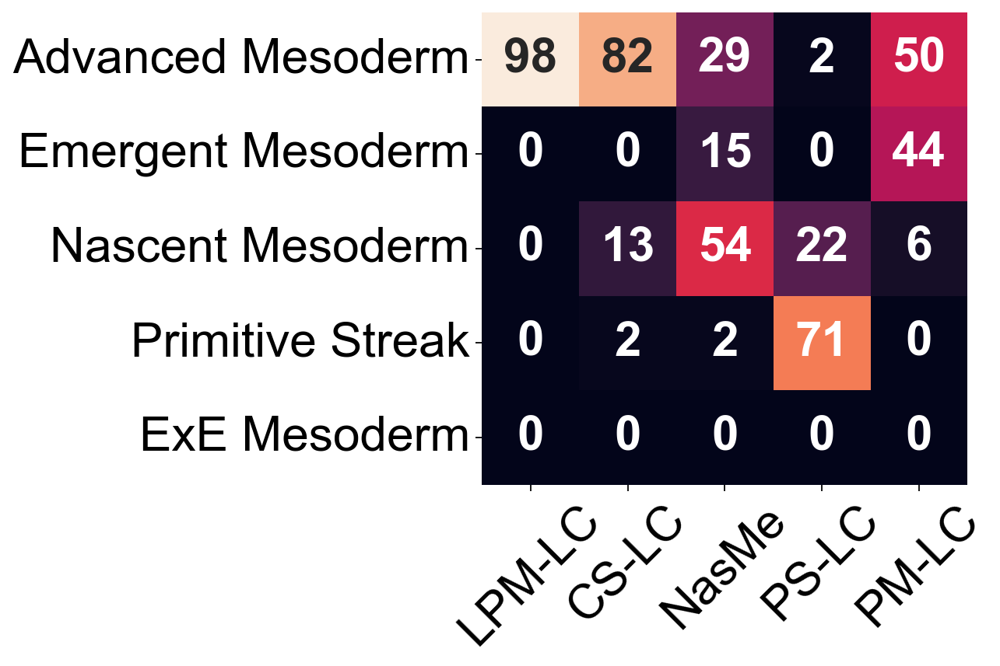

In [281]:
clustertype = 'leiden_sub';
predicttype = 'knnpred';#'knnpred_sub';
obs_tab = adata_full[adata_full.obs['batch'] == 'Query'].obs.copy()
obs_summary = obs_tab.groupby([clustertype,predicttype])[['time']].count() # time is just a random column without nan
leiden_cell_count = obs_summary.groupby(clustertype).transform(lambda x: x.sum())
percentmap = obs_summary / leiden_cell_count * 100
percentmap = percentmap.pivot_table(index=predicttype, columns=clustertype);
percentmap.columns = [j for (i,j) in percentmap.columns];

if clustertype == 'leiden':
    percentmap = percentmap[['AdvMe','NasMe','APS-LC','PPS-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
    colnames = ['AdvMe','NasMe','APS-LC','PPS-LC'];
else:
    percentmap = percentmap[['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
    colnames = ['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC'];
    
import seaborn as sns
fs = 28;
plt.figure(figsize=(5, 5))
h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.0f')
h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
h.set_xlabel('')
h.set_ylabel('')
for text in h.texts:
    text.set_fontweight('bold')
for label in h.xaxis.get_ticklabels():
#    label.set_fontweight('bold')
    label.set_fontsize(fs)
for label in h.yaxis.get_ticklabels():
#    label.set_fontweight('bold')
    label.set_fontsize(fs)
plt.savefig(dataDir + 'heatmap_'+clustertype + '_' + predicttype+'_v2.png', bbox_inches='tight')